In [1]:
import pandas as pd
import numpy as np
import dalmatian as dm
import pdb
import math
import TerraFunction as terra
import sys
sys.path.insert(0, '../ccle_processing/')
import CCLE_postp_function as ccle
import rpy2
%load_ext rpy2.ipython
from taigapy import TaigaClient
from IPython.display import Image,display
from IPython.core.display import HTML 
%load_ext autoreload
%autoreload 2

In [2]:
tc = TaigaClient()
dm.__version__

'0.0.10'

## initializing data

In [3]:
maleintervals = "gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642da12f8/immediate/intervalsXY.list"
femaleintervals = "gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642da12f8/immediate/intervalsXX.list"
sample_values_todrop = ["sj_diseases","sj_datasets","attr_age_at_diagnosis","attr_sex","attr_race","attr_ethnicity","attr_diagnosis"]
outpath = "sample.tsv"
spamplepath = "SAMPLE_INFO.txt"
bucketname= "gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642da12f8/"
samplesetname = "WGS_CNV_stjude"
namespace="rmc-rnaseq"
workspace="St_Jude_RMS"

## uploading the required interval list of chromosomes for the PON

In [3]:
! echo "chr1\nchr2\nchr3\nchr4\nchr5\nchr6\nchr7\nchr8\nchr9\nchr10\nchr11\nchr12\nchr13\nchr14\nchr15\nchr16\nchr17\nchr18\nchr19\nchr20\nchr21\nchr22\nchrX\nchrY" > intervalsXY.list
! echo "chr1\nchr2\nchr3\nchr4\nchr5\nchr6\nchr7\nchr8\nchr9\nchr10\nchr11\nchr12\nchr13\nchr14\nchr15\nchr16\nchr17\nchr18\nchr19\nchr20\nchr21\nchr22\nchrX\nchrX" > intervalsXX.list
! gsutil cp intervalsXY.list $maleintervals
! gsutil cp intervalsXX.list $femaleintervals

Copying file://intervalsXY.list [Content-Type=text/plain]...
/ [1 files][  133.0 B/  133.0 B]                                                
Operation completed over 1 objects/133.0 B.                                      
Copying file://intervalsXX.list [Content-Type=text/plain]...
/ [1 files][  133.0 B/  133.0 B]                                                
Operation completed over 1 objects/133.0 B.                                      


## loading and Displaying data

In [4]:
newsample = pd.read_csv(spamplepath,sep='\t')
newsample

,file_path,subject_name,sample_name,sample_type,sequencing_type,file_type,description,sj_diseases,sj_datasets,sj_pmid_accessions,sj_ega_accessions,attr_age_at_diagnosis,attr_diagnosis,attr_ethnicity,attr_race,attr_sex,sj_dataset_accessions,sj_embargo_date,sj_genome_build
0,/immediate/bam/SJRHB002_G.WholeGenome.bam.bai,SJRHB002,SJRHB002_G,Germline,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040",EGAS00001000256,2.530000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,White,Female,SJC-DS-1001,"2018,Jul 23",NaN
1,/immediate/bam/SJRHB002_G.WholeGenome.bam,SJRHB002,SJRHB002_G,Germline,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040",EGAS00001000256,2.530000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,White,Female,SJC-DS-1001,"2018,Jul 23",NaN
2,/immediate/bam/SJRHB005_G.WholeGenome.bam,SJRHB005,SJRHB005_G,Germline,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040",EGAS00001000256,9.240000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,Black or African American,Female,SJC-DS-1001,"2018,Jul 23",NaN
3,/immediate/bam/SJRHB005_G.WholeGenome.bam.bai,SJRHB005,SJRHB005_G,Germline,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040",EGAS00001000256,9.240000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,Black or African American,Female,SJC-DS-1001,"2018,Jul 23",NaN
4,/immediate/bam/SJRHB001_D.WholeGenome.bam,SJRHB001,SJRHB001_D,Diagnosis,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040,28854978",EGAS00001000256,4.410000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,Black or African American,Male,SJC-DS-1001,"2018,Jul 23",NaN
5,/immediate/bam/SJRHB001_D.WholeGenome.bam.bai,SJRHB001,SJRHB001_D,Diagnosis,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040,28854978",EGAS00001000256,4.410000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,Black or African American,Male,SJC-DS-1001,"2018,Jul 23",NaN
6,/immediate/bam/SJRHB001_G.WholeGenome.bam,SJRHB001,SJRHB001_G,Germline,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040",EGAS00001000256,4.410000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,Black or African American,Male,SJC-DS-1001,"2018,Jul 23",NaN
7,/immediate/bam/SJRHB001_G.WholeGenome.bam.bai,SJRHB001,SJRHB001_G,Germline,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040",EGAS00001000256,4.410000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,Black or African American,Male,SJC-DS-1001,"2018,Jul 23",NaN
8,/immediate/bam/SJRHB003_D.WholeGenome.bam.bai,SJRHB003,SJRHB003_D,Diagnosis,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040,28854978",EGAS00001000256,3.470000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,Black or African American,Female,SJC-DS-1001,"2018,Jul 23",NaN
9,/immediate/bam/SJRHB003_D.WholeGenome.bam,SJRHB003,SJRHB003_D,Diagnosis,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040,28854978",EGAS00001000256,3.470000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,Black or African American,Female,SJC-DS-1001,"2018,Jul 23",NaN


In [5]:
#only keeping whole genome
for i,val in enumerate(newsample["file_path"]):
    if val.split('/')[-1].split('.')[1] != "WholeGenome" or val.split('/')[-2]!= "bam":
        newsample = newsample.drop(i)
    elif val.split('/')[1] != 'gs:':
        newsample["file_path"][i]="gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642da12f8/immediate/bam_wg/"+newsample["file_path"][i].split('/')[-1]
newsample = newsample.reset_index(drop=True)
newsample = newsample.rename(index=str, columns={"sample_name": "sample_id", "subject_name": "participant_id","file_path":"WGS_bam"})
currfile=""
bai = ['']*int(newsample.shape[0])
#creating an array of bai and adding it to their coresponding bams
for i in newsample.index:
    currfile=newsample["WGS_bam"][i]
    if currfile.split('/')[-1].split('.')[-1] == "bai":
        bai[int(newsample[newsample["WGS_bam"]==currfile[:-4]].index.values[0])] = currfile
newsample["WGS_bam_index"]=pd.Series(bai,index=newsample.index)
#removing original bai rows
for i in newsample.index: 
    currfile=newsample["WGS_bam"][i]
    if currfile.split('/')[-1].split('.')[-1] == "bai":
        newsample = newsample.drop(i)
newsample = newsample.reset_index(drop=True)
newsample["sample_set"]=pd.Series([samplesetname]*int(newsample.shape[0]),index=newsample.index)
newsample.set_index("sample_id",inplace=True,drop=True)
newsample = newsample[newsample.columns.tolist()[1:]+[newsample.columns.tolist()[0]]]
newsample = newsample.loc[~newsample.index.duplicated(keep='first')]
newsample.to_csv(outpath,sep="\t")
newsample

/Users/jeremie/anaconda2/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


,participant_id,sample_type,sequencing_type,file_type,description,sj_diseases,sj_datasets,sj_pmid_accessions,sj_ega_accessions,attr_age_at_diagnosis,attr_diagnosis,attr_ethnicity,attr_race,attr_sex,sj_dataset_accessions,sj_embargo_date,sj_genome_build,WGS_bam_index,sample_set,WGS_bam
sample_id,,,,,,,,,,,,,,,,,,,,
SJRHB002_G,SJRHB002,Germline,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040",EGAS00001000256,2.530000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,White,Female,SJC-DS-1001,"2018,Jul 23",NaN,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...,WGS_CNV_stjude,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...
SJRHB005_G,SJRHB005,Germline,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040",EGAS00001000256,9.240000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,Black or African American,Female,SJC-DS-1001,"2018,Jul 23",NaN,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...,WGS_CNV_stjude,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...
SJRHB001_D,SJRHB001,Diagnosis,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040,28854978",EGAS00001000256,4.410000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,Black or African American,Male,SJC-DS-1001,"2018,Jul 23",NaN,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...,WGS_CNV_stjude,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...
SJRHB001_G,SJRHB001,Germline,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040",EGAS00001000256,4.410000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,Black or African American,Male,SJC-DS-1001,"2018,Jul 23",NaN,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...,WGS_CNV_stjude,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...
SJRHB003_D,SJRHB003,Diagnosis,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040,28854978",EGAS00001000256,3.470000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,Black or African American,Female,SJC-DS-1001,"2018,Jul 23",NaN,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...,WGS_CNV_stjude,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...
SJRHB004_D,SJRHB004,Diagnosis,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040,28854978",EGAS00001000256,9.310000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,White,Male,SJC-DS-1001,"2018,Jul 23",NaN,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...,WGS_CNV_stjude,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...
SJRHB002_D,SJRHB002,Diagnosis,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040,28854978",EGAS00001000256,2.530000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,White,Female,SJC-DS-1001,"2018,Jul 23",NaN,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...,WGS_CNV_stjude,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...
SJRHB000026_R4,SJRHB000026,Relapse,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),NaN,NaN,NaN,NaN,NaN,NaN,NaN,SJC-DS-1001,"2018,Jul 23",NaN,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...,WGS_CNV_stjude,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...
SJRHB005_D,SJRHB005,Diagnosis,WGS,bam,NaN,RHB,Pediatric Cancer Genome Project (PCGP),"23232254,24332040,28854978",EGAS00001000256,9.240000,"NOS,Rhabdomyosarcoma",Not Hispanic or Latino,Black or African American,Female,SJC-DS-1001,"2018,Jul 23",NaN,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...,WGS_CNV_stjude,gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642d...


Removing a corrupted sample

In [6]:
newsample=newsample.drop("SJRHB007_G")
newsample=newsample.drop("SJRHB010_D")

## creating set for each samples

In [5]:
wm = dm.WorkspaceManager(namespace, workspace)

samplesetname

In [10]:
wm.upload_samples(newsample)
wm.update_sample_set(samplesetname,newsample.index)

Successfully imported 18 participants.
Successfully imported 38 samples.


KeyboardInterrupt: 

## creating the sample set for normal cells with m/f

In [11]:
normalsXX = newsample[(newsample["sample_type"]=="Germline") & (newsample["sj_datasets"]!="Clinical Pilot") &(newsample["attr_sex"]=="Female")].index.values
normalsXY = newsample[(newsample["sample_type"]=="Germline") & (newsample["sj_datasets"]!="Clinical Pilot") &(newsample["attr_sex"]=="Male")].index.values

In [16]:
normalsXX

array(['SJRHB002_G', 'SJRHB005_G', 'SJRHB009_G', 'SJRHB013_G',
       'SJRHB003_G', 'SJRHB008_G', 'SJRHB006_G', 'SJRHB030264_G1',
       'SJRHB030115_G1'], dtype=object)

In [13]:
wm.update_sample_set(samplesetname+"_normals_XY",normalsXY.tolist())

Successfully imported 1 sample sets:
  * WGS_CNV_stjude_normals_XY (6 samples)


In [19]:
wm.update_sample_set(samplesetname+"_normals_XX1",normalsXX.tolist())

Successfully imported 1 sample sets:
  * WGS_CNV_stjude_normals_XX1 (9 samples)


## creating the sample set for cancer patients with/without germline cells sequenced

I am quite positive that the clinical pilot are not germline and have been misclassified

In [37]:
# diagnosis samples
diagnosis = newsample[(newsample["sample_type"]!="Germline") | (newsample["sj_datasets"]=="Clinical Pilot")]['participant_id'].values.tolist()
# germline samples
germline = newsample[(newsample["sample_type"]=="Germline") & (newsample["sj_datasets"]!="Clinical Pilot")]['participant_id'].values.tolist()
# assert that we have them all in total
assert(len(diagnosis)+len(germline)==newsample.shape[0]) 
# people without a matching germline
patientswithout = set(diagnosis) - set(germline)
# samples from patients without a matching germline
toprocessPON = newsample[newsample["participant_id"].isin(patientswithout)].index.values.tolist()
# samples from patients with a matching germline
not_toprocessPON = newsample[~newsample["participant_id"].isin(patientswithout)][newsample["sample_type"]=="Germline"].index.values.tolist()

/Users/jeremie/anaconda2/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if sys.path[0] == '':


In [75]:
wm.update_sample_set(samplesetname+"_not_toprocessPON",not_toprocessPON)
wm.update_sample_set(samplesetname+"_toprocessPON",toprocessPON)

In [30]:
cnv_pon = wm.get_config("CNV_Somatic_Panel_Workflow")
cnv_pon

{'deleted': False,
 'inputs': {'CNVSomaticPanelWorkflow.normal_bams': 'this.samples.WGS_bam',
  'CNVSomaticPanelWorkflow.preemptible_attempts': '5',
  'CNVSomaticPanelWorkflow.normal_bais': 'this.samples.WGS_bam_index',
  'CNVSomaticPanelWorkflow.bin_length': '1000',
  'CNVSomaticPanelWorkflow.ref_fasta_dict': 'workspace.ref_dict',
  'CNVSomaticPanelWorkflow.gatk4_jar_override': '',
  'CNVSomaticPanelWorkflow.mem_gb_for_preprocess_intervals': '16',
  'CNVSomaticPanelWorkflow.PreprocessIntervals.cpu': '8',
  'CNVSomaticPanelWorkflow.pon_entity_id': 'this.name',
  'CNVSomaticPanelWorkflow.CollectCounts.cpu': '8',
  'CNVSomaticPanelWorkflow.CollectCounts.disk_space_gb': '500',
  'CNVSomaticPanelWorkflow.ref_fasta_fai': 'workspace.ref_fasta_fai',
  'CNVSomaticPanelWorkflow.AnnotateIntervals.cpu': '8',
  'CNVSomaticPanelWorkflow.mem_gb_for_annotate_intervals': '16',
  'CNVSomaticPanelWorkflow.gatk_docker': 'workspace.gatk_docker',
  'CNVSomaticPanelWorkflow.ref_fasta': 'workspace.ref_fasta'

In [31]:
cnv_pon['inputs']['CNVSomaticPanelWorkflow.normal_bams'] = 'this.samples.WGS_bam'
cnv_pon['inputs']['CNVSomaticPanelWorkflow.normal_bais'] = 'this.samples.WGS_bam_index'

## runing male PON
#a['inputs']['CNVSomaticPanelWorkflow.intervals'] = '"'+maleintervals+'"'


#wm.create_submission(a, setname+"_normals_XY", 'sample_set', use_callcache=True)

## running female PON
cnv_pon['inputs']['CNVSomaticPanelWorkflow.intervals'] = '"'+femaleintervals+'"'
wm.update_config(cnv_pon)
wm.create_submission(cnv_pon['name'], samplesetname+"_normals_XX1", 'sample_set', use_callcache=True)

User provided a full method configuration, which did not match the configuration already present on the workspace
Either upload the provided configuration, or use a different reference type to fetch the online version


ConfigNotUnique: 'Provided configuration did not match live version gatk/CNV_Somatic_Panel_Workflow'

## running specific PON

In [38]:
pairs = newsample[~newsample["participant_id"].isin(patientswithout)][newsample["sample_type"]!="Germline"].index.values.tolist()
nomatched = newsample[newsample["participant_id"].isin(patientswithout)].index.values.tolist()

/Users/jeremie/anaconda2/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


In [43]:
sampleset = wm.get_sample_sets()
samples = wm.get_samples()
new_dataset = pd.DataFrame(columns=[samplesetname+"_id","read_count_pon","WGS_bam_tumor","WGS_bam_normal","WGS_bam_normal_index","WGS_bam_tumor_index","intervals"])

In [34]:
samples=samples.drop(labels="SJRHB007_G")
samples=samples.drop(labels="SJRHB010_D")

In [44]:
for val in nomatched:
    sex = "_normals_XY" if newsample["attr_sex"][val]!="Female" else "_normals_XX1" 
    intervals = maleintervals if samples["attr_sex"][val]!="Female" else femaleintervals 
    new_dataset = new_dataset.append({
        samplesetname+"_id": val,
        "read_count_pon": sampleset["read_count_pon"][samplesetname+sex],
        "WGS_bam_tumor": samples["WGS_bam"][val],
        "WGS_bam_normal": "",
        "WGS_bam_normal_index": "",
        "WGS_bam_tumor_index": samples["WGS_bam_index"][val],
        "intervals": intervals
    },ignore_index=True)

In [45]:
for val in pairs:
    paired_germline = samples[samples["participant"]==samples["participant"][val]][samples["sample_type"]=="Germline"]
    sex = "_normals_XY" if samples["attr_sex"][val]!="Female" else "_normals_XX" 
    read_count_pon = sampleset["read_count_pon"][samplesetname+sex]
    intervals = maleintervals if samples["attr_sex"][val]!="Female" else femaleintervals 
    new_dataset = new_dataset.append({
        samplesetname+"_id": val,
        "read_count_pon": read_count_pon,
        "WGS_bam_tumor": samples["WGS_bam"][val],
        "WGS_bam_normal": paired_germline["WGS_bam"].values[0],
        "WGS_bam_normal_index": paired_germline["WGS_bam_index"].values[0],
        "WGS_bam_tumor_index": samples["WGS_bam_index"][val],
        "intervals": intervals
    },ignore_index=True)

/Users/jeremie/anaconda2/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


In [46]:
new_dataset.set_index(samplesetname+"_id",inplace=True,drop=True)

In [47]:
wm.upload_entities(samplesetname,new_dataset)

Traceback (most recent call last):
  File "/Users/jeremie/anaconda2/envs/py36/lib/python3.6/site-packages/dalmatian/wmanager.py", line 897, in upload_entities
    super().upload_entities(etype, df, index)
  File "/Users/jeremie/anaconda2/envs/py36/lib/python3.6/site-packages/dalmatian/base.py", line 193, in upload_entities
    raise APIException('{} import failed.'.format(et.capitalize()), s)
dalmatian.core.APIException: Pairs_cnv1 import failed.: (400) : {
  "statusCode": 400,
  "source": "FireCloud",
  "timestamp": 1559323885740,
  "causes": [],
  "stackTrace": [],
  "message": "ErrorReport(FireCloud,Unknown firecloud model entity type: pair_CNV1,Some(400 Bad Request),List(),List(),None)"
}



In [57]:
wm.update_sample_set(sample_ids=new_dataset.index.values.tolist(),sample_set_id=samplesetname)

Sample set "WGS_CNV_stjude" (21 samples) successfully updated.


In [83]:
CNVpipeline = wm.get_config('CNV_Somatic_Pair_Workflow')
CNVpipeline

APIException: Insufficient data in cache to complete operation: (200) : {"accessLevel":"OWNER","bucketOptions":{"requesterPays":false},"canCompute":true,"canShare":true,"catalog":false,"owners":["aleehong@broadinstitute.org","gkugener@broadinstitute.org","paolella@broadinstitute.org","jkalfon@broadinstitute.org"],"workspace":{"attributes":{"ref_fasta":"gs://genomics-public-data/resources/broad/hg38/v0/Homo_sapiens_assembly38.fasta","HG19_rsem_reference":"gs://fc-ca01b420-53e8-4922-b152-8d5e9bdcc07f/references/rsem_reference_hg19_gencode19.tar.gz","ref_dict":"gs://genomics-public-data/resources/broad/hg38/v0/Homo_sapiens_assembly38.dict","ref_bwa_alt":"gs://genomics-public-data/resources/broad/hg38/v0/Homo_sapiens_assembly38.fasta.64.alt","known_indels_idx_array":{"itemsType":"AttributeValue","items":["gs://genomics-public-data/resources/broad/hg38/v0/Mills_and_1000G_gold_standard.indels.hg38.vcf.gz.tbi","gs://genomics-public-data/resources/broad/hg38/v0/Homo_sapiens_assembly38.known_indels.vcf.gz.tbi"]},"ice_xy_intervals_no_pad":"gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/intervals/ice_hg38_lifted_chrXY.no_header.list","description":"## St Jude RMS\n\nThis workspace contains the files and analysis of the St Jude's RMS cohort. All samples from St Jude use hg38 alignment, so the tasks in this workspace are configured to use hg38 as well.\n\n### WES\n\nFor the WES data, this workspace contains pipelines to run copy number calling on matched tumor-normal pairs. PONs were generated for this cohort using all unique normal samples, which can be found in the data tab.\n\n### RNAseq\n\nOf note for the RNAseq data: three files were duplicated in the St Jude datasets, although the file sizes differed (for samples SJRHB007_D, SJRHB010_D, SJRHB013_D). Both versions of the files were uploaded to this workspace. The version that comes from selecting option '0' when using the DNAnexus command line to download the file is used as the default in the samples for those three samples. The other version is saved under the sample with the prefix 'V1_' (e.g V1_SJRHB010_D). I also include a column called file_id_dx that corresponds to the file id when trying to download it from the dx command line (in case the options provided in the command line prompt are not consistent).\n\nRNAseq data was processed through the GTEx pipeline as is done for CCLE samples. Fusions were called using out of the box STAR-Fusion v1.6, as is done for CCLE samples for 19Q2.","ref_name":"hg38","known_indels_array":{"itemsType":"AttributeValue","items":["gs://genomics-public-data/resources/broad/hg38/v0/Mills_and_1000G_gold_standard.indels.hg38.vcf.gz","gs://genomics-public-data/resources/broad/hg38/v0/Homo_sapiens_assembly38.known_indels.vcf.gz"]},"hg38_star_fusion_ctat_files":{"itemsType":"AttributeValue","items":["gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/AnnotFilterRule.pm","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/blast_pairs.idx","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/blast_pairs.idx.prev.1553723931","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/fusion_annot_lib.idx","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/pfam_domains.dbm","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_annot.cds","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_annot.gtf","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_annot.gtf.gene_spans","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_annot.gtf.mini.sortu","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_annot.pep","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_annot.prot_info.dbm","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.fai","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/trans.blast.align_coords.align_coords.dat","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/trans.blast.align_coords.align_coords.dbm"]},"exon_usage_script":"gs://fc-secure-639c94ba-2b0d-4960-92fc-9cd50046a968/references/ExonUsage_STAR.R","pon_st_jude_xx":"gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642da12f8/4e279bdd-4118-4f61-9a94-e60278d336df/CNVSomaticPanelWorkflow/d9339204-ca56-4f6e-b92c-e02107e1fcfe/call-CreateReadCountPanelOfNormals/WES_XX_NORMALS_ONE_PER_PARTICIPANT.pon.hdf5","gatk_docker":"us.gcr.io/broad-gatk/gatk:4.0.8.0","ref_bwa_bwt":"gs://genomics-public-data/resources/broad/hg38/v0/Homo_sapiens_assembly38.fasta.64.bwt","interval_list":"gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642da12f8/immediate/intervals.list","ref_bwa_ann":"gs://genomics-public-data/resources/broad/hg38/v0/Homo_sapiens_assembly38.fasta.64.ann","aggregate_fusions_script":"gs://fc-1eb02a97-12db-4548-94f0-8fd155a99d9e/references/fusions/generate_single_fusion_file.R","ice_y_only_intervals_no_pad":"gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/intervals/ice_hg38_lifted_chrY_only.no_header.list","ref_fasta_fai":"gs://genomics-public-data/resources/broad/hg38/v0/Homo_sapiens_assembly38.fasta.fai","ref_bwa_pac":"gs://genomics-public-data/resources/broad/hg38/v0/Homo_sapiens_assembly38.fasta.64.pac","common_sites_hg38":"gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/intervals/common_sites_hg38_lifted.list","genes_gtf":"gs://fc-secure-639c94ba-2b0d-4960-92fc-9cd50046a968/references/gtex/references_gtex_gencode.v29.GRCh38.ERCC.genes.collapsed_only.gtf","rsem_reference":"gs://fc-secure-639c94ba-2b0d-4960-92fc-9cd50046a968/references/gtex/rsem_reference_GRCh38_gencode29_ercc.tar.gz","cn_single_file_script":"gs://fc-secure-fbcce9b4-7b36-443f-974f-7165ece39714/references/generate_single_seg_file.R","hg38_star_fusion_ctat_star_index_files":{"itemsType":"AttributeValue","items":["gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/Genome","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/SA","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/SAindex","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/build.ok","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/chrLength.txt","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/chrName.txt","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/chrNameLength.txt","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/chrStart.txt","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/exonGeTrInfo.tab","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/exonInfo.tab","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/geneInfo.tab","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/genomeParameters.txt","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/sjdbInfo.txt","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/sjdbList.fromGTF.out.tab","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/sjdbList.out.tab","gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/GRCh38_gencode_v29_CTAT_lib_Mar272019.plug-n-play/ctat_genome_lib_build_dir/ref_genome.fa.star.idx/transcriptInfo.tab"]},"ice_xx_intervals_no_pad":"gs://fc-secure-bb273170-1bd6-405c-82c7-67fb31fcda40/references/intervals/ice_hg38_lifted_chrXX.no_header.list","dbsnp_138":"gs://genomics-public-data/resources/broad/hg38/v0/Homo_sapiens_assembly38.dbsnp138.vcf","star_index":"gs://fc-secure-639c94ba-2b0d-4960-92fc-9cd50046a968/references/gtex/STAR_genome_GRCh38_noALT_noHLA_noDecoy_ERCC_v29_oh100.tar.gz","ref_bwa_sa":"gs://genomics-public-data/resources/broad/hg38/v0/Homo_sapiens_assembly38.fasta.64.sa","ref_bwa_amb":"gs://genomics-public-data/resources/broad/hg38/v0/Homo_sapiens_assembly38.fasta.64.amb","HG19_star_index":"gs://fc-ca01b420-53e8-4922-b152-8d5e9bdcc07f/references/star_index_v19_oh100.tar.gz","dbsnp_138_idx":"gs://genomics-public-data/resources/broad/hg38/v0/Homo_sapiens_assembly38.dbsnp138.vcf.idx"},"authorizationDomain":[{"membersGroupName":"st-jude-rms"}],"bucketName":"fc-secure-fd4c24cf-6bfd-410a-9bca-e02642da12f8","createdBy":"gkugener@broadinstitute.org","createdDate":"2019-04-25T13:16:12.537Z","isLocked":false,"lastModified":"2019-06-17T15:20:06.559Z","name":"St_Jude_RMS","namespace":"rmc-rnaseq","workflowCollectionName":"fd4c24cf-6bfd-410a-9bca-e02642da12f8","workspaceId":"fd4c24cf-6bfd-410a-9bca-e02642da12f8"},"workspaceSubmissionStats":{"lastFailureDate":"2019-06-06T20:34:57.025Z","lastSuccessDate":"2019-06-06T20:53:54.089Z","runningSubmissionsCount":0}}

In [33]:
CNVpipeline['inputs']['CNVSomaticPairWorkflow.tumor_bam'] = 'this.WGS_bam_tumor'
CNVpipeline['inputs']['CNVSomaticPairWorkflow.tumor_bam_idx'] = 'this.WGS_bam_tumor_index'
CNVpipeline['inputs']['CNVSomaticPairWorkflow.normal_bam'] = 'this.WGS_bam_normal'
CNVpipeline['inputs']['CNVSomaticPairWorkflow.normal_bam_idx'] = 'this.WGS_bam_normal_index'
CNVpipeline['inputs']['CNVSomaticPairWorkflow.padding'] = 250
CNVpipeline['rootEntityType']= 'pair'
CNVpipeline['inputs']['CNVSomaticPairWorkflow.common_sites'] = 'workspace.common_sites_hg38'
## runing male PON
CNVpipeline['inputs']['CNVSomaticPairWorkflow.intervals'] = 'workspace.interval_list'
CNVpipeline['inputs']['CNVSomaticPairWorkflow.read_count_pon'] = 'this.read_count_pon'
CNVpipeline['inputs']['CNVSomaticPairWorkflow.bin_length'] = 1000
wm.update_config(CNVpipeline)
submission_id = wm.create_submission(CNVpipeline['name'],etype='sample_set',entity=samplesetname,expression='this.samples')
terra.wait_for_submission(submission_id)

In [58]:
aggregate = wm.get_config('Aggregate_CN_seg_files')
aggregate

{'deleted': False,
 'inputs': {'aggregate_CN_segments_wrkflw.aggregate_CN_segments.disk_space': '10',
  'aggregate_CN_segments_wrkflw.aggregate_CN_segments.num_preempt': '5',
  'aggregate_CN_segments_wrkflw.aggregate_CN_segments.aggregate_seg_files_script': '"gs://fc-secure-fbcce9b4-7b36-443f-974f-7165ece39714/references/generate_single_seg_file.R"',
  'aggregate_CN_segments_wrkflw.aggregate_CN_segments.memory': '5',
  'aggregate_CN_segments_wrkflw.aggregate_CN_segments.sample_set_id': 'this.name',
  'aggregate_CN_segments_wrkflw.aggregate_CN_segments.sample_seg_files': 'this.pair_CNVs.called_copy_ratio_segments_tumor'},
 'methodConfigVersion': 17,
 'methodRepoMethod': {'methodName': 'Aggregate_CN_seg_files',
  'methodVersion': 2,
  'methodNamespace': 'gkugener',
  'methodUri': 'agora://gkugener/Aggregate_CN_seg_files/2',
  'sourceRepo': 'agora'},
 'name': 'Aggregate_CN_seg_files',
 'namespace': 'gkugener',
 'outputs': {'aggregate_CN_segments_wrkflw.aggregate_CN_segments.combined_cn_fi

In [69]:
wm.update_pair_set(samplesetname,val)

TypeError: Expected tuple, got str

In [59]:
aggregate['inputs']['aggregate_CN_segments_wrkflw.aggregate_CN_segments.sample_seg_files'] = 'this.pair.called_copy_ratio_segments_tumor'
wm.update_config(aggregate)
submission_id = wm.create_submission(config = aggregate['name'], entity=samplesetname)
terra.wait_for_submission(submission_id)

Successfully updated configuration gkugener/Aggregate_CN_seg_files


AttributeError: 'WorkspaceManager' object has no attribute 'get_pair_CNV_sets'

In [10]:
aggregated = wm.get_entities(etype="pair_CNV_set")["combined_seg_file"].values[1]
aggregated

'gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642da12f8/a537302e-2487-4159-80a8-aa2bde2e3ed7/aggregate_CN_segments_wrkflw/2f086e56-b62f-4dd6-bf26-d656d76f6d2f/call-aggregate_CN_segments/Aggregate_CN_seg_files_2019-06-17T15-31-07.called.seg'

In [14]:
! gsutil cp $aggregated temp/cn.aggregated.called.seg

Copying gs://fc-secure-fd4c24cf-6bfd-410a-9bca-e02642da12f8/a537302e-2487-4159-80a8-aa2bde2e3ed7/aggregate_CN_segments_wrkflw/2f086e56-b62f-4dd6-bf26-d656d76f6d2f/call-aggregate_CN_segments/Aggregate_CN_seg_files_2019-06-17T15-31-07.called.seg...
/ [1 files][  1.5 MiB/  1.5 MiB]                                                
Operation completed over 1 objects/1.5 MiB.                                      


you can even add `-i df -w 5 -h 5 --units in -r 200`

In [4]:
%%R 
source("gkugener/RScripts/load_libraries_and_annotations.R")

2019-06-18 06:55:10::WARNING  R[write to console]: 
Attaching package: ‘dplyr’


2019-06-18 06:55:10::WARNING  R[write to console]: The following objects are masked from ‘package:plyr’:

    arrange, count, desc, failwith, id, mutate, rename, summarise,
    summarize


2019-06-18 06:55:10::WARNING  R[write to console]: The following objects are masked from ‘package:stats’:

    filter, lag


2019-06-18 06:55:10::WARNING  R[write to console]: The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


2019-06-18 06:55:11::WARNING  R[write to console]: ── Attaching packages ─────────────────────────────────────── tidyverse 1.2.1 ──

2019-06-18 06:55:11::WARNING  R[write to console]: ✔ ggplot2 3.1.1     ✔ readr   1.3.1
✔ tibble  2.1.3     ✔ purrr   0.3.2
✔ tidyr   0.8.3     ✔ stringr 1.4.0
✔ ggplot2 3.1.1     ✔ forcats 0.4.0

2019-06-18 06:55:11::WARNING  R[write to console]: ── Conflicts ────────────────────────────────────────── tidyverse_conflicts()


Error in library(sva) : there is no package called ‘sva’
Calls: <Anonymous> ... withVisible -> source -> withVisible -> eval -> eval -> library


In [5]:
%%R
source("../ccle_processing/CCLE_postp_function.R")

2019-06-18 06:55:11::WARNING  R[write to console]: Loading required package: AnnotationDbi

2019-06-18 06:55:11::WARNING  R[write to console]: Loading required package: stats4

2019-06-18 06:55:11::WARNING  R[write to console]: Loading required package: BiocGenerics

2019-06-18 06:55:11::WARNING  R[write to console]: Loading required package: parallel

2019-06-18 06:55:11::WARNING  R[write to console]: 
Attaching package: ‘BiocGenerics’


2019-06-18 06:55:11::WARNING  R[write to console]: The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


2019-06-18 06:55:11::WARNING  R[write to console]: The following objects are masked from ‘package:dplyr’:

    combine, intersect, setdiff, union


2019-06-18 06:55:11::WARNING  R[write to console]: The following objects are masked from ‘package:stats’:

    IQR, mad, s

In [6]:
%%R 
a <- interpolate_gaps_in_segmented(process_segments(
    "temp/cn.aggregated.called.seg"))
segments <- extend_ends_of_segments(a$segs)

[1] 0


2019-06-18 06:55:21::WARNING  R[write to console]: Parsed with column specification:
cols(
  X1 = col_character(),
  X2 = col_double(),
  X3 = col_double(),
  X4 = col_character(),
  X5 = col_character()
)



In [7]:
%%R
segments[170:200,]

# A tibble: 31 x 7
   DepMap_ID      seqnames    start      end Num_Probes Segment_Mean Source   
   <chr>          <fct>       <dbl>    <dbl>      <dbl>        <dbl> <chr>    
 1 SJRHB000026_R3 chr2     61433001 62350000        915         1.29 Other WES
 2 SJRHB000026_R3 chr2     62350001 63844000       1485         1.26 Other WES
 3 SJRHB000026_R3 chr2     63844001 64397000        553         1.31 Other WES
 4 SJRHB000026_R3 chr2     64397001 65937000       1535         1.33 Other WES
 5 SJRHB000026_R3 chr2     65937001 67750000       1799         1.29 Other WES
 6 SJRHB000026_R3 chr2     67750001 67920000        170         1.25 Other WES
 7 SJRHB000026_R3 chr2     67920001 68799000        873         1.28 Other WES
 8 SJRHB000026_R3 chr2     68799001 70111000       1312         1.33 Other WES
 9 SJRHB000026_R3 chr2     70111001 70293000        182         1.39 Other WES
10 SJRHB000026_R3 chr2     70293001 71810000       1505         1.29 Other WES
# … with 21 more rows


In [8]:
%%R
segments %<>% dplyr::mutate(Source='st_jude')

In [35]:
%%R 
write.table(segments, file = "temp/wgs.st.jude.segmented.cn", sep = ',', quote = F, row.names = F) 
# What we upload to taiga

In [9]:
%%R
allENTREZG <- generate_entrez_genes()

In [18]:
%%R
segments %<>% mutate(seqnames=gsub('chr', '', seqnames)) 
head(segments)


# A tibble: 6 x 7
  DepMap_ID      seqnames    start      end Num_Probes Segment_Mean Source 
  <chr>          <chr>       <dbl>    <dbl>      <dbl>        <dbl> <chr>  
1 SJRHB000026_R3 1               1  2670000       1784  0.996       st_jude
2 SJRHB000026_R3 1         2670001  2719500          6  2.43        st_jude
3 SJRHB000026_R3 1         2719501  6506000       3713  0.951       st_jude
4 SJRHB000026_R3 1         6506001 13146500       6368  0.996       st_jude
5 SJRHB000026_R3 1        13146501 13225000          3  0.000000951 st_jude
6 SJRHB000026_R3 1        13225001 16603500       3242  0.979       st_jude


In [20]:
%%R
data <- generate_gene_level_matrix_from_segments(allENTREZG, segments)

In [21]:
%%R
head(data$gene_level_data_hg38)

               A1BG (1) NAT2 (10) ADA (100) CDH2 (1000) AKT3 (10000)
SJRHB000026_R3 1.199043 1.6789881  1.266063   0.9251127    1.6231733
SJRHB000026_R4 1.215122 1.3759700  1.187409   0.9381523    1.5651338
SJRHB000026_R5 1.185315 1.2271376  1.185965   0.9157927    1.4530879
               GAGE12F (100008586) RNA5-8SN5 (100008587) RNA18SN5 (100008588)
SJRHB000026_R3           1.7686419              1.236662             1.236662
SJRHB000026_R4           1.7141211              1.210429             1.210429
SJRHB000026_R5           1.7406209              1.224008             1.224008
               RNA28SN5 (100008589) LINC02584 (100009613) POU5F1P5 (100009667)
SJRHB000026_R3             1.236662             0.9662517            0.9768737
SJRHB000026_R4             1.210429             0.9578489            0.9783401
SJRHB000026_R5             1.224008             0.9488658            0.9325112
               ZBTB11-AS1 (100009676) MED6 (10001) NR2E3 (10002)
SJRHB000026_R3              0.9

SJRHB000026_R3            1.7686419           1.7686419          1.7686419
SJRHB000026_R4            1.7141211           1.7141211          1.7141211
SJRHB000026_R5            1.7406209           1.7406209          1.7406209
               MIR891B (100126304) MIR888 (100126306) MIR892B (100126307)
SJRHB000026_R3           1.7686419          1.7686419           1.7686419
SJRHB000026_R4           1.7141211          1.7141211           1.7141211
SJRHB000026_R5           1.7406209          1.7406209           1.7406209
               MIR541 (100126308) MIR875 (100126309) MIR876 (100126310)
SJRHB000026_R3          0.9877446          1.6798518          0.9417265
SJRHB000026_R4          0.9826088          1.3689569          0.9428126
SJRHB000026_R5          0.9378467          1.2283767          0.9143726
               MIR147B (100126311) MIR744 (100126313) MIR877 (100126314)
SJRHB000026_R3           0.9396322          0.9731452          0.9690124
SJRHB000026_R4           0.9600890          0

SJRHB000026_R4                0.9661928            1.0147434
SJRHB000026_R5                0.9353648            0.9564079
               LOC100128988 (100128988) LOC100128993 (100128993)
SJRHB000026_R3                 1.314426                1.6839030
SJRHB000026_R4                 1.229502                1.3759700
SJRHB000026_R5                 1.208378                1.2271376
               LOC100129027 (100129027) PKP4-AS1 (100129029)
SJRHB000026_R3                1.2929128             1.326419
SJRHB000026_R4                1.3228761             1.279693
SJRHB000026_R5                1.2128759             1.186308
               LOC100129034 (100129034) LOC100129046 (100129046)
SJRHB000026_R3                0.9862211                0.9818864
SJRHB000026_R4                0.9851013                0.9948949
SJRHB000026_R5                0.9301762                1.0718314
               LOC100129055 (100129055) SEMA3F-AS1 (100129060)
SJRHB000026_R3                0.9244588            

From cffi callback <function _consolewrite_ex at 0x7fdf1804f9d8>:
Traceback (most recent call last):
  File "/home/jeremie/miniconda3/lib/python3.7/site-packages/rpy2/rinterface_lib/callbacks.py", line 127, in _consolewrite_ex
    consolewrite_print(s)
  File "/home/jeremie/miniconda3/lib/python3.7/site-packages/rpy2/rinterface_lib/callbacks.py", line 111, in consolewrite_print
    print(s, end='', flush=True)
  File "/home/jeremie/miniconda3/lib/python3.7/site-packages/ipykernel/iostream.py", line 349, in flush
    if not evt.wait(self.flush_timeout):
  File "/home/jeremie/miniconda3/lib/python3.7/threading.py", line 552, in wait
    signaled = self._cond.wait(timeout)
  File "/home/jeremie/miniconda3/lib/python3.7/threading.py", line 300, in wait
    gotit = waiter.acquire(True, timeout)
KeyboardInterrupt


             0.9301762                 1.198891
               LINC01126 (100129726) MIR193BHG (100129781) CCDC152 (100129792)
SJRHB000026_R3              1.351672             0.9532781           0.9295163
SJRHB000026_R4              1.350515             0.9459954           0.9209904
SJRHB000026_R5              1.219332             1.0826756           0.8395837
               SLC25A21-AS1 (100129794) ZNF807 (100129800)
SJRHB000026_R3                0.9542730           1.155043
SJRHB000026_R4                0.9519838           1.185322
SJRHB000026_R5                0.9332872           1.171140
               MRVI1-AS1 (100129827) COL4A2-AS2 (100129836) ZNF737 (100129842)
SJRHB000026_R3             1.6284258              1.2973134           1.221297
SJRHB000026_R4             1.6076541              1.2426810           1.172420
SJRHB000026_R5             1.4072416              1.0398800           1.242437
               PCOLCE-AS1 (100129845) SCOC-AS1 (100129858)
SJRHB000026_R3           

SJRHB000026_R5             0.9306180            1.1853154
               FAM83A-AS1 (100131726) USP30-AS1 (100131733) ARMCX4 (100131755)
SJRHB000026_R3               1.695564             0.9716179          1.7686419
SJRHB000026_R4               1.371626             0.9761799          1.7141211
SJRHB000026_R5               1.241318             0.9401722          1.7406209
               PET100 (100131801) LINC00271 (100131814) UBE2DNL (100131816)
SJRHB000026_R3           1.196004             0.9643274           1.7686419
SJRHB000026_R4           1.220430             0.9626258           1.7141211
SJRHB000026_R5           1.127043             1.0971791           1.7406209
               CADM3-AS1 (100131825) ZNF717 (100131827) INSYN2B (100131897)
SJRHB000026_R3             1.5010853          0.9588314           0.9113607
SJRHB000026_R4             1.4300861          0.9669083           0.8967352
SJRHB000026_R5             1.3552237          0.9559374           0.9256085
               KRT

SJRHB000026_R5           1.4281228           1.4281228           1.4281228
               PATE3 (100169851) PEG3-AS1 (100169890) SNAR-A13 (100169959)
SJRHB000026_R3         1.0083979             1.199043             1.221319
SJRHB000026_R4         1.0145571             1.215122             1.256416
SJRHB000026_R5         0.9690547             1.151595             1.156301
               DBIL5P2 (100169989) BCL2L10 (10017) SNAR-B2 (100170217)
SJRHB000026_R3            1.263323       0.9396322            1.229313
SJRHB000026_R4            1.246313       0.9600890            1.271717
SJRHB000026_R5            1.175079       0.9523086            1.172420
               SNAR-C2 (100170218) SNAR-C4 (100170219) SNAR-E (100170220)
SJRHB000026_R3            1.221319            1.221319           1.240309
SJRHB000026_R4            1.256416            1.256416           1.256416
SJRHB000026_R5            1.156301            1.156301           1.180578
               SNAR-H (100170221) SNAR-I (100

SJRHB000026_R3              0.9663214                0.9964228
SJRHB000026_R4              0.9331591                1.0136088
SJRHB000026_R5              0.8565700                1.2418750
               LNCOC1 (100288181) HMGN3-AS1 (100288198)
SJRHB000026_R3           1.664245             0.9423350
SJRHB000026_R4           1.286295             0.9211577
SJRHB000026_R5           1.167478             1.0809314
               LOC100288203 (100288203) LOC100288208 (100288208)
SJRHB000026_R3                0.9709386                1.2740925
SJRHB000026_R4                0.9600890                1.2362084
SJRHB000026_R5                0.9523086                1.0403818
               LOC100288254 (100288254) KRTAP22-2 (100288287)
SJRHB000026_R3                0.9702786             1.2409010
SJRHB000026_R4                0.9670611             1.2495486
SJRHB000026_R5                0.9256085             1.1711907
               KRTAP21-3 (100288323) NPIPA5 (100288332) NCAM1-AS1 (100288346)
S

SJRHB000026_R3             0.9877446            1.237467           0.9927518
SJRHB000026_R4             0.9826088            1.295044           1.0147434
SJRHB000026_R5             0.9378467            1.187431           0.9564079
               MIR1324 (100302212) MIR1181 (100302213) MIR1277 (100302214)
SJRHB000026_R3           0.9579950            1.247237           1.7686419
SJRHB000026_R4           0.9669083            1.278030           1.7141211
SJRHB000026_R5           0.9559374            1.252726           1.7406209
               MIR1827 (100302217) MIR1285-1 (100302218) MIR1245A (100302219)
SJRHB000026_R3           0.9716179             0.9710254             1.718298
SJRHB000026_R4           0.9353129             0.9717169             1.642850
SJRHB000026_R5           0.9401722             0.9439792             1.480010
               MIR1293 (100302220) MIR1291 (100302221) MIR1911 (100302222)
SJRHB000026_R3           0.9801748           0.9801748           1.7686419
SJRHB00

SJRHB000026_R4           0.9798175            1.900605              1.307111
SJRHB000026_R5           0.9551432            1.682351              1.194182
               MIR4274 (100422826) MIR3160-1 (100422827) MIR4287 (100422828)
SJRHB000026_R3           0.9551446              1.323739            1.658657
SJRHB000026_R4           0.9502981              1.307111            1.347633
SJRHB000026_R5           0.9294183              1.194182            1.205863
               MIR4319 (100422829) MIR3171 (100422830) MIR3191 (100422832)
SJRHB000026_R3           0.9565286           0.9542730            1.240309
SJRHB000026_R4           0.9520710           0.9519838            1.256416
SJRHB000026_R5           0.9194965           0.9332872            1.180578
               MIR3188 (100422833) MIR3183 (100422835) MIR1193 (100422837)
SJRHB000026_R3            1.221297           0.9731452           0.9877446
SJRHB000026_R4            1.249026           0.9721124           0.9826088
SJRHB000026_R

SJRHB000026_R4             1.2184500           1.7141211             1.5079044
SJRHB000026_R5             1.1813062           1.7406209             1.4213955
               MIR3138 (100423011) MIR3177 (100423012) MIR4310 (100423013)
SJRHB000026_R3           0.9551446           1.0082630           0.9709386
SJRHB000026_R4           0.9502981           1.0016635           0.9600890
SJRHB000026_R5           0.9294183           1.0795941           0.9523086
               MIR3196 (100423014) MIR4289 (100423015) MIR3159 (100423016)
SJRHB000026_R3            1.305955           0.9652262           1.6284258
SJRHB000026_R4            1.200780           0.9659249           1.5672062
SJRHB000026_R5            1.215164           0.9187721           1.4034844
               MIR3139 (100423017) MIR3156-3 (100423018) MIR4307 (100423019)
SJRHB000026_R3           0.9576298             1.2296460           0.9542730
SJRHB000026_R4           0.9564417             1.2184500           0.9519838
SJRHB000026

SJRHB000026_R3           0.9622129            0.9862211            1.6722528
SJRHB000026_R4           0.9661928            0.9851013            1.3685091
SJRHB000026_R5           0.9353648            0.9301762            1.2316770
               MIR3613 (100500908) MIR3908 (100500909) MIR3944 (100500911)
SJRHB000026_R3            1.309459           0.9786060           0.9570101
SJRHB000026_R4            1.276569           0.9953032           0.9579047
SJRHB000026_R5            1.055339           0.9397768           0.9254885
               MIR3674 (100500912) MIR3714 (100500913) MIR3610 (100500914)
SJRHB000026_R3           1.5717938           0.9475329            1.637597
SJRHB000026_R4           1.2842936           0.9520954            1.350050
SJRHB000026_R5           1.1682370           0.9446390            1.205703
               MIR3915 (100500915) MIR3180-5 (100500916) MIR3651 (100500918)
SJRHB000026_R3           1.7686419             1.0082630           0.9652262
SJRHB000026_R4 

SJRHB000026_R3             1.280997            1.7332142              1.351672
SJRHB000026_R4             1.241650            1.4992822              1.350515
SJRHB000026_R5             1.184532            1.4032976              1.219332
               LRRC72 (100506049) LINC01005 (100506050) RNASEH1-AS1 (100506054)
SJRHB000026_R3          0.9421052             0.9762753               0.9681007
SJRHB000026_R4          0.9418074             0.9407257               0.9734994
SJRHB000026_R5          0.9422547             0.9439792               0.9428414
               SMG1P7 (100506060) DACT3-AS1 (100506068) RBFADN (100506070)
SJRHB000026_R3          0.9744351              1.240309          1.0037090
SJRHB000026_R4          0.9725060              1.256416          1.0190056
SJRHB000026_R5          1.0654464              1.180578          0.9614768
               LOC100506071 (100506071) LOC100506082 (100506082)
SJRHB000026_R3                0.9542730                1.5610276
SJRHB000026_R

SJRHB000026_R3            0.9793307                0.9555975
SJRHB000026_R4            0.9783286                0.9331591
SJRHB000026_R5            0.9523086                0.7916826
               LOC100506691 (100506691) PCAT6 (100506696) LINC00327 (100506697)
SJRHB000026_R3                0.9786060         1.7915248              1.305829
SJRHB000026_R4                0.9953032         1.5745919              1.266440
SJRHB000026_R5                0.9397768         1.4583338              1.222908
               LINC02308 (100506700) EBLN3P (100506710) ALOX12-AS1 (100506713)
SJRHB000026_R3             0.9489309          0.9767634              0.9731452
SJRHB000026_R4             0.9440551          0.9791087              0.9721124
SJRHB000026_R5             0.9378467          0.9311884              0.9523508
               NUP50-DT (100506714) LINC00901 (100506724)
SJRHB000026_R3            0.9780547             0.9482866
SJRHB000026_R4            0.9757301             0.9584666
SJRHB00

SJRHB000026_R5                 1.238984                0.9401722
               KCNQ5-IT1 (100507381) LOC100507384 (100507384)
SJRHB000026_R3             0.9423350                 1.323739
SJRHB000026_R4             0.9623663                 1.252552
SJRHB000026_R5             1.1010699                 1.159497
               LOC100507387 (100507387) LOC100507388 (100507388)
SJRHB000026_R3                0.9702786                0.9469886
SJRHB000026_R4                0.9670611                0.9418864
SJRHB000026_R5                0.9256085                0.9264487
               LOC100507389 (100507389) LINC01968 (100507391) SENCR (100507392)
SJRHB000026_R3                0.9597749             1.0054233         1.0009695
SJRHB000026_R4                0.9553233             0.9784140         0.9875112
SJRHB000026_R5                0.9499042             0.9588819         0.9521389
               INTS6-AS1 (100507398) LRP4-AS1 (100507401) LINC02539 (100507406)
SJRHB000026_R3             

SJRHB000026_R3               1.0082630             0.9913154
SJRHB000026_R4               1.0016635             1.0061434
SJRHB000026_R5               1.0795941             0.9564079
               RAD51L3-RFFL (100529207) RNASEK-C17orf49 (100529209)
SJRHB000026_R3                0.9356118                   0.9731452
SJRHB000026_R4                0.9502085                   0.9721124
SJRHB000026_R5                0.9210695                   0.9523508
               TMEM256-PLSCR3 (100529211) ZNF559-ZNF177 (100529215)
SJRHB000026_R3                  0.9731452                  1.186332
SJRHB000026_R4                  0.9721124                  1.220724
SJRHB000026_R5                  0.9523508                  1.220879
               RPS10-NUDT3 (100529239) ZNF816-ZNF321P (100529240)
SJRHB000026_R3               0.9783096                   1.174271
SJRHB000026_R4               0.9768622                   1.185900
SJRHB000026_R5               1.1232912                   1.152237
         

SJRHB000026_R3           1.2525472           0.9710254            1.636035
SJRHB000026_R4           1.2027110           0.9717169            1.575440
SJRHB000026_R5           1.0403818           0.9439792            1.622620
               MIR4782 (100616208) MIR4737 (100616210) MIR4709 (100616211)
SJRHB000026_R3            1.281446           0.9913154           0.9927566
SJRHB000026_R4            1.247044           1.0061434           0.9936998
SJRHB000026_R5            1.176891           0.9564079           0.9378467
               MIR3689F (100616212) MIR4437 (100616213) MIR4667 (100616214)
SJRHB000026_R3            0.9862211            1.547781           0.9767634
SJRHB000026_R4            0.9851013            1.486319           0.9791087
SJRHB000026_R5            0.9301762            1.399438           1.4085649
               MIR548AL (100616215) MIR4797 (100616216) MIR3135B (100616218)
SJRHB000026_R3            0.9662517           0.9990515            0.9783096
SJRHB000026_R4   

SJRHB000026_R3           0.9663214           0.6262189            0.9789499
SJRHB000026_R4           0.9331591           0.6545358            0.9774908
SJRHB000026_R5           0.8565700           0.6680116            1.0704408
               MIR4732 (100616385) MIR4654 (100616386) MIR3064 (100616387)
SJRHB000026_R3           0.9893830           1.6219451           0.9913154
SJRHB000026_R4           1.0042984           1.5552904           1.0061434
SJRHB000026_R5           0.9474653           1.4350649           0.9564079
               MIR4723 (100616388) MIR4463 (100616389) MIR4427 (100616390)
SJRHB000026_R3           0.9893830           0.9423350           1.6377918
SJRHB000026_R4           1.0042984           0.9623663           1.5605624
SJRHB000026_R5           0.9474653           1.1209811           1.4489562
               MIR4684 (100616391) MIR4773-1 (100616392) MIR4657 (100616393)
SJRHB000026_R3           0.9752534              1.293256           0.9635237
SJRHB000026_R4    

SJRHB000026_R3            0.9713715            0.7085591      1.645964
SJRHB000026_R4            0.9909856            0.7007351      1.568487
SJRHB000026_R5            0.9422547            0.6999176      1.422788
               ATP9A (10079) CDH10 (1008) PDCD7 (10081) GPC6 (10082)
SJRHB000026_R3      1.326122    0.9496310     0.9793307    1.2715913
SJRHB000026_R4      1.232342    0.9399018     0.9783286    1.2239885
SJRHB000026_R5      1.203601    0.8395837     0.9523086    1.0405123
               LINC00501 (100820709) MYZAP (100820829) USH1C (10083)
SJRHB000026_R3             0.9954998         0.9793307     1.6284258
SJRHB000026_R4             0.9769550         0.9783286     1.5465849
SJRHB000026_R5             0.9647680         0.9523086     1.4034844
               PQBP1 (10084) LINC00506 (100846978) MIR5197 (100846991)
SJRHB000026_R3     1.7686419             1.0019858           0.9622129
SJRHB000026_R4     1.7141211             0.9646637           0.9441258
SJRHB000026_R5     1.7

SJRHB000026_R3           0.9687270           1.7686419           1.7686419
SJRHB000026_R4           0.9784140           1.7141211           1.7141211
SJRHB000026_R5           0.9588819           1.7406209           1.7406209
               SYP-AS1 (100873921) ZFX-AS1 (100873922) HLX-AS1 (100873924)
SJRHB000026_R3           1.7686419           1.7686419           1.6385628
SJRHB000026_R4           1.7141211           1.7141211           1.5661431
SJRHB000026_R5           1.7406209           1.7406209           1.4469931
               DLG3-AS1 (100873930) DPYD-AS1 (100873932) DPYD-AS2 (100873933)
SJRHB000026_R3            1.7686419            0.9436966            0.9436966
SJRHB000026_R4            1.7141211            0.9373917            0.9373917
SJRHB000026_R5            1.7406209            1.0325045            1.0325045
               MTOR-AS1 (100873935) GRM7-AS1 (100873937) LNX1-AS1 (100873939)
SJRHB000026_R3            0.9958960            0.9639659            0.9469886
SJRHB00

SJRHB000026_R4             1.2239885             1.2510141
SJRHB000026_R5             1.0405123             1.0553394
               LINC00440 (100874172) LINC00443 (100874173)
SJRHB000026_R3             1.2728091             1.2580018
SJRHB000026_R4             1.2239885             1.1829835
SJRHB000026_R5             1.0405123             1.0398800
               LINC00446 (100874175) LINC00448 (100874176)
SJRHB000026_R3             1.2621943             1.2525472
SJRHB000026_R4             1.2168033             1.2144785
SJRHB000026_R5             1.0403818             1.0403818
               LINC00454 (100874178) LINC00457 (100874179)
SJRHB000026_R3              1.333129             1.2810990
SJRHB000026_R4              1.292118             1.2528728
SJRHB000026_R5              1.078944             1.2069760
               LINC00459 (100874180) LINC00424 (100874182)
SJRHB000026_R3             1.2525472              1.284429
SJRHB000026_R4             1.2144785              1.2390

SJRHB000026_R5             1.0794497             1.146362             0.9572376
               LOC100996325 (100996325) POTEB (100996331) FAM230H (100996335)
SJRHB000026_R3                0.9663214         1.1719573           0.9780547
SJRHB000026_R4                0.9331591         1.1599286           0.9757301
SJRHB000026_R5                0.8565700         1.1852341           0.9496817
               LINC02169 (100996338) LINC01664 (100996342)
SJRHB000026_R3             0.9558771             0.9877795
SJRHB000026_R4             0.9527509             0.9844863
SJRHB000026_R5             1.0503215             0.9598321
               LINC02140 (100996345) CA3-AS1 (100996348)
SJRHB000026_R3             0.9558771            1.610731
SJRHB000026_R4             0.9527509            1.319722
SJRHB000026_R5             1.0503215            1.196333
               LOC100996349 (100996349) LOC100996351 (100996351)
SJRHB000026_R3                1.1163296                 1.236413
SJRHB000026_R4

SJRHB000026_R4              0.9784140              1.331052
SJRHB000026_R5              0.9588819              1.220213
               STPG2-AS1 (101410545) AKAP9 (10142) CLEC3A (10143)
SJRHB000026_R3             0.9657830     0.9710254      0.9704259
SJRHB000026_R4             0.9665572     0.9717169      0.9686692
SJRHB000026_R5             0.9355269     0.9439792      1.0467805
               FAM13A (10144) RNVU1-8 (101447996) LOC101448202 (101448202)
SJRHB000026_R3      0.9657830           1.5839447                0.9862211
SJRHB000026_R4      0.9665572           1.4841768                0.9851013
SJRHB000026_R5      0.9355269           1.3994549                0.9301762
               G3BP1 (10146) SUGP2 (10147) EBI3 (10148) ADGRG2 (10149)
SJRHB000026_R3     0.9622129      1.221297     1.236413      1.7686419
SJRHB000026_R4     0.9441258      1.249026     1.266531      1.7141211
SJRHB000026_R5     0.9353648      1.238649     1.161229      1.7406209
               CDH17 (1015) MBNL

SJRHB000026_R5             0.9365689          0.9353648
               LOC101927100 (101927100) ITFG1-AS1 (101927102)
SJRHB000026_R3                0.9622129             0.9558771
SJRHB000026_R4                0.9661928             0.9527509
SJRHB000026_R5                0.9353648             1.0503215
               SUCLG2-AS1 (101927111) LINC01581 (101927112)
SJRHB000026_R3              0.9456492             0.9593911
SJRHB000026_R4              0.9669083             0.9700083
SJRHB000026_R5              0.9559374             0.9469807
               LINC01933 (101927115) PLCG1-AS1 (101927117)
SJRHB000026_R3             0.9622129              1.314426
SJRHB000026_R4             0.9441258              1.229502
SJRHB000026_R5             0.9353648              1.208378
               LOC101927120 (101927120) LINC02016 (101927123)
SJRHB000026_R3                0.9498990             0.9524049
SJRHB000026_R4                0.9481479             0.9553233
SJRHB000026_R5                0.92

SJRHB000026_R5                0.9254885                0.9439792
               LOC101927421 (101927421) GNA14-AS1 (101927422) PANO1 (101927423)
SJRHB000026_R3                0.9622129             0.9652262          1.645964
SJRHB000026_R4                0.9661928             0.9659249          1.568487
SJRHB000026_R5                0.9353648             0.9187721          1.468714
               LINC01903 (101927430) LINC01790 (101927431)
SJRHB000026_R3             0.9494020              1.571712
SJRHB000026_R4             0.9419693              1.477763
SJRHB000026_R5             0.9266529              1.407089
               LINC01255 (101927433) LOC101927434 (101927434)
SJRHB000026_R3             0.9695546                0.9542525
SJRHB000026_R4             0.9685269                0.9718671
SJRHB000026_R5             0.9332950                1.0638177
               LOC101927437 (101927437) LINC01800 (101927438)
SJRHB000026_R3                 1.324982              1.327480
SJRHB00

SJRHB000026_R4             0.9800464                0.9596811
SJRHB000026_R5             0.9415222                1.1344586
               TMEM132D-AS2 (101927735) LINC02202 (101927740)
SJRHB000026_R3                0.9786060             0.9557830
SJRHB000026_R4                0.9579306             0.9509557
SJRHB000026_R5                0.9397768             0.9256085
               LOC101927746 (101927746) ATP6V1B1-AS1 (101927750)
SJRHB000026_R3                0.9710254                 1.286163
SJRHB000026_R4                0.9717169                 1.251201
SJRHB000026_R5                0.9439792                 1.172255
               LOC101927751 (101927751) LOC101927752 (101927752)
SJRHB000026_R3                0.9593911                1.5717938
SJRHB000026_R4                0.9700083                1.2842936
SJRHB000026_R5                0.9469807                1.1682370
               RNFT1-DT (101927755) LOC101927759 (101927759)
SJRHB000026_R3            0.9913154            

               LOC101928093 (101928093) LOC101928098 (101928098)
SJRHB000026_R3                0.9702786                0.9818864
SJRHB000026_R4                0.9670611                0.9948949
SJRHB000026_R5                0.9256085                1.0718314
               PCAT7 (101928099) LOC101928100 (101928100) IL6R-AS1 (101928101)
SJRHB000026_R3         0.9652262                0.9638977            1.6596385
SJRHB000026_R4         0.9659249                0.9342393            1.5771042
SJRHB000026_R5         0.9187721                0.9320408            1.4582236
               LOC101928103 (101928103) LINC01482 (101928104)
SJRHB000026_R3                 1.522249             0.9913154
SJRHB000026_R4                 1.533884             1.0061434
SJRHB000026_R5                 1.249117             0.9564079
               LOC101928105 (101928105) LOC101928107 (101928107)
SJRHB000026_R3                0.9681987                1.2716944
SJRHB000026_R4                0.9553233       

SJRHB000026_R4             0.9600890                0.9578489
SJRHB000026_R5             0.9523086                0.9488658
               LOC101928445 (101928445) LOC101928446 (101928446)
SJRHB000026_R3                0.9702786                0.9704259
SJRHB000026_R4                0.9670611                0.9686692
SJRHB000026_R5                0.9256085                1.0729992
               C5orf67 (101928448) LINC02426 (101928449)
SJRHB000026_R3           0.9652409             0.9716179
SJRHB000026_R4           0.9653119             0.9753088
SJRHB000026_R5           0.9353648             0.9401722
               LOC101928453 (101928453) LINC01412 (101928455)
SJRHB000026_R3                0.6370864              1.295137
SJRHB000026_R4                0.6823198              1.268821
SJRHB000026_R5                0.6787019              1.195833
               LINC01756 (101928460) LOC101928461 (101928461)
SJRHB000026_R3             0.9752534                0.9643274
SJRHB000026_R4  

SJRHB000026_R4                0.9044571                 1.195014
SJRHB000026_R5                0.8935851                 1.128768
               LOC101928807 (101928807) LOC101928809 (101928809)
SJRHB000026_R3                0.9531083                0.9657830
SJRHB000026_R4                0.9467596                0.9665572
SJRHB000026_R5                0.9439792                0.9355269
               LOC101928812 (101928812) LINC02535 (101928820)
SJRHB000026_R3                 1.323739             0.9423350
SJRHB000026_R4                 1.252552             0.9616321
SJRHB000026_R5                 1.159497             1.0924604
               LOC101928823 (101928823) LOC101928834 (101928834)
SJRHB000026_R3                0.9688082                0.6262189
SJRHB000026_R4                0.9773444                0.6680931
SJRHB000026_R5                0.9511594                0.6680116
               LOC101928837 (101928837) PWRN3 (101928840)
SJRHB000026_R3                0.9739604     

SJRHB000026_R3             0.9793307               1.0054233
SJRHB000026_R4             0.9783286               0.9784140
SJRHB000026_R5             0.9523086               0.9588819
               LINC02261 (101929199) MKX-AS1 (101929202) LINC01729 (101929207)
SJRHB000026_R3             0.9551446           0.9695196             1.2318999
SJRHB000026_R4             0.9502981           0.9714731             1.1553917
SJRHB000026_R5             0.9294183           0.9417356             1.1823958
               LOC101929208 (101929208) LOC101929210 (101929210)
SJRHB000026_R3                0.9484437                0.9657830
SJRHB000026_R4                0.9530495                0.9665572
SJRHB000026_R5                0.9316545                0.9355269
               SMIM2-AS1 (101929212) CTD-2201I18.1 (101929215)
SJRHB000026_R3              1.315022                 0.9652409
SJRHB000026_R4              1.291513                 0.9653119
SJRHB000026_R5              1.055339                

SJRHB000026_R4             1.5621500             0.9734994
SJRHB000026_R5             1.4368137             0.9428414
               LOC101929570 (101929570) LOC101929572 (101929572)
SJRHB000026_R3                 1.226863                0.7062143
SJRHB000026_R4                 1.186389                0.7110826
SJRHB000026_R5                 1.136930                0.6993119
               LOC101929574 (101929574) LOC101929577 (101929577)
SJRHB000026_R3                0.9535173                0.9554737
SJRHB000026_R4                0.9579047                0.9564417
SJRHB000026_R5                0.9254885                0.9389010
               LOC101929579 (101929579) GTF2IP23 (101929580)
SJRHB000026_R3                0.9591119            0.9762753
SJRHB000026_R4                0.9584666            0.9749567
SJRHB000026_R5                0.9491599            0.9439792
               LINC01241 (101929582) LINC02443 (101929584)
SJRHB000026_R3             0.9417265             0.9638977


SJRHB000026_R4      0.9428126     0.9722188       1.233462       1.265645
SJRHB000026_R5      0.9143726     1.1086016       1.238984       1.168350
               SSX3 (10214) OLIG2 (10215) LINC00384 (102157400)
SJRHB000026_R3    1.7686419     1.2716944              1.299453
SJRHB000026_R4    1.7141211     1.2781445              1.266592
SJRHB000026_R5    1.7406209     1.1806677              1.213199
               PCBP2-OT1 (102157401) AK6 (102157402) PRG4 (10216)
SJRHB000026_R3             0.9801748       0.9652409    1.6884846
SJRHB000026_R4             0.9705087       0.9653119    1.4986910
SJRHB000026_R5             0.9397514       0.9353648    1.4076962
               CTDSPL (10217) ANGPTL7 (10218) KLRG1 (10219)
SJRHB000026_R3      0.9457403       0.9958960     0.9638977
SJRHB000026_R4      0.9577732       1.0105677     0.9342393
SJRHB000026_R5      0.9509873       1.2162013     0.9320408
               FBXW7-AS1 (102191832) CDK7 (1022) GDF11 (10220) TRIB1 (10221)
SJRHB000026_R3 

SJRHB000026_R4           0.9721124           1.0078906           1.1781572
SJRHB000026_R5           0.9523508           0.9564079           1.1758304
               MIR6870 (102465525) MIR6872 (102465526) MIR6876 (102465527)
SJRHB000026_R3           1.2416349           0.7085591            1.687993
SJRHB000026_R4           1.1569704           0.6800930            1.385826
SJRHB000026_R5           1.1516577           0.6999176            1.202269
               MIR6877 (102465528) MIR6878 (102465529) MIR6881 (102465530)
SJRHB000026_R3           0.9862211           1.7055499           0.9793307
SJRHB000026_R4           0.9851013           1.6292308           0.9783286
SJRHB000026_R5           0.9301762           1.4571365           0.9523086
               MIR6882 (102465531) MIR6883 (102465532) MIR6885 (102465533)
SJRHB000026_R3           0.9793307           0.9731452            1.200797
SJRHB000026_R4           0.9783286           0.9721124            1.216569
SJRHB000026_R5           

SJRHB000026_R4           0.9717169           0.9777191           1.0078906
SJRHB000026_R5           0.9439792           0.9635597           0.9564079
               MIR6889 (102466758) MIR6894 (102466759) MIR7108 (102466806)
SJRHB000026_R3           0.9780547           1.7686419            1.583349
SJRHB000026_R4           0.9757301           1.7141211            1.591063
SJRHB000026_R5           0.9496817           1.7406209            1.471224
               MIR7151 (102466814) MIR7155 (102466815) MIR7159 (102466816)
SJRHB000026_R3           0.9768737           0.9887893           0.9783096
SJRHB000026_R4           0.9783401           1.0006448           0.9768622
SJRHB000026_R5           0.9325112           0.9635597           1.1110371
               MIR7705 (102466854) MIR6516 (102466864) MIR7848 (102466865)
SJRHB000026_R3           1.6798518           0.9913154            1.563119
SJRHB000026_R4           1.3689569           1.0061434            1.275096
SJRHB000026_R5           

               LINC01766 (102723617) ATXN2-AS (102723619) CT45A10 (102723631)
SJRHB000026_R3              1.155043            0.9716179           1.7686419
SJRHB000026_R4              1.185322            0.9761799           1.7141211
SJRHB000026_R5              1.171140            0.9401722           1.7406209
               LINC02259 (102723640) HID1-AS1 (102723641) LINC01499 (102723644)
SJRHB000026_R3             0.9793307            0.9913154             1.5368251
SJRHB000026_R4             0.9783286            1.0061434             1.4376824
SJRHB000026_R5             0.9523086            0.9564079             1.3677163
               LOC102723649 (102723649) LOC102723661 (102723661)
SJRHB000026_R3                0.9643274                0.9818864
SJRHB000026_R4                0.9626258                0.9373917
SJRHB000026_R5                1.0971791                1.0718314
               LOC102723665 (102723665) LOC102723672 (102723672)
SJRHB000026_R3                0.9882048    

               LINC01594 (102724774) LOC102724776 (102724776)
SJRHB000026_R3              1.289649                0.9576298
SJRHB000026_R4              1.257917                0.9564417
SJRHB000026_R5              1.192936                0.9365689
               LOC102724784 (102724784) LOC102724804 (102724804)
SJRHB000026_R3                1.6284258                1.7096701
SJRHB000026_R4                1.5876963                1.4111027
SJRHB000026_R5                1.4072416                1.2404590
               LINC02062 (102724810) LOC102724814 (102724814)
SJRHB000026_R3             0.9622129                0.9542730
SJRHB000026_R4             0.9661928                0.9519838
SJRHB000026_R5             0.9353648                0.9332872
               LANCL1-AS1 (102724820) ZNF337-AS1 (102724826) MIATNB (102724827)
SJRHB000026_R3               1.588009               1.288502          0.9780547
SJRHB000026_R4               1.538498               1.188568          0.9757301
SJRH

SJRHB000026_R5              0.9587782             0.9254885
               LINC01461 (103695366) LINC01048 (103695431)
SJRHB000026_R3             0.9796002              1.313299
SJRHB000026_R4             0.9718671              1.256317
SJRHB000026_R5             1.0638177              1.211047
               LINC01167 (103695432) LINC01322 (103695433)
SJRHB000026_R3             0.9570101             0.9406905
SJRHB000026_R4             0.9579047             0.9337939
SJRHB000026_R5             0.9254885             0.9379078
               LINC01396 (103695434) BBOX1-AS1 (103695435)
SJRHB000026_R3             0.9551446             1.6174476
SJRHB000026_R4             0.9502981             1.5890814
SJRHB000026_R5             0.9294183             1.4243108
               LINC01269 (103695436) CITED2 (10370) SEMA3A (10371)
SJRHB000026_R3             0.9756557      0.9643274      0.9710254
SJRHB000026_R4             0.9800464      0.9626258      0.9717169
SJRHB000026_R5             0.94

               HAX1 (10456) LUNAR1 (104564224) MHRT (104564225) GPNMB (10457)
SJRHB000026_R3    1.6725902          0.9593911        0.9542730     0.9713715
SJRHB000026_R4    1.6025252          0.9700083        0.9519838     0.9909856
SJRHB000026_R5    1.4582236          0.9469807        0.9332872     0.9422547
               BAIAP2 (10458) MAD2L2 (10459) CDX4 (1046) TACC3 (10460)
SJRHB000026_R3      0.9913154      0.9958960   1.7686419     0.9551446
SJRHB000026_R4      1.0061434      1.0105677   1.7141211     0.9502981
SJRHB000026_R5      0.9564079      1.2162013   1.7406209     0.9551671
               MERTK (10461) LOC104613533 (104613533) CLEC10A (10462)
SJRHB000026_R3      1.326301                0.9593911       0.9731452
SJRHB000026_R4      1.298859                0.9700083       0.9721124
SJRHB000026_R5      1.205088                0.9469807       0.9523508
               SLC30A9 (10463) PIBF1 (10464) ENPP7P13 (104644205) PPIH (10465)
SJRHB000026_R3       0.9471961      1.268573 

               G2E3-AS1 (105370431) LINC02313 (105370439)
SJRHB000026_R3            0.9542730             0.9542730
SJRHB000026_R4            0.9519838             0.9519838
SJRHB000026_R5            0.9332872             0.9332872
               LOC105370457 (105370457) SEC23A-AS1 (105370458)
SJRHB000026_R3                0.9542730              0.9542730
SJRHB000026_R4                0.9519838              0.9519838
SJRHB000026_R5                0.9332872              0.9332872
               LOC105370473 (105370473) LINC02303 (105370479)
SJRHB000026_R3                0.9454618             0.9454618
SJRHB000026_R4                0.9563317             0.9563317
SJRHB000026_R5                0.9415222             0.9415222
               LOC105370489 (105370489) LINC02310 (105370496)
SJRHB000026_R3                0.9756557             0.9756557
SJRHB000026_R4                0.9563317             0.9563317
SJRHB000026_R5                0.9415222             0.9415222
               LOC10

               LINC01683 (105372746) LINC01684 (105372751)
SJRHB000026_R3             1.2112990             1.2363584
SJRHB000026_R4             1.2067368             1.2388358
SJRHB000026_R5             1.1660891             1.1672900
               LOC105372795 (105372795) LINC01694 (105372840)
SJRHB000026_R3                1.3312892             1.2929128
SJRHB000026_R4                1.3197503             1.3228761
SJRHB000026_R5                1.1957767             1.2128759
               LINC01717 (105372893) LINC01774 (105372894)
SJRHB000026_R3             1.7417795             1.7417795
SJRHB000026_R4             1.5357262             1.5357262
SJRHB000026_R5             1.4220439             1.4220439
               LINC01696 (105372897) LINC01710 (105372925)
SJRHB000026_R3             1.7417795             1.8120013
SJRHB000026_R4             1.5357262             1.5985202
SJRHB000026_R5             1.4220439             1.4469931
               LINC02257 (105372950) LOC1053

               LOC105375115 (105375115) LOC105375166 (105375166)
SJRHB000026_R3                0.9902749                0.9421052
SJRHB000026_R4                0.9901891                0.9418074
SJRHB000026_R5                0.9574201                0.9366896
               LOC105375218 (105375218) LOC105375297 (105375297)
SJRHB000026_R3                0.9713715                0.8699793
SJRHB000026_R4                0.9909856                0.8665320
SJRHB000026_R5                0.9422547                0.8994413
               LOC105375304 (105375304) UPK3B (105375355) LINC00972 (105375380)
SJRHB000026_R3                0.9713715         1.0311384             0.9710254
SJRHB000026_R4                0.9909856         1.0200027             0.9717169
SJRHB000026_R5                0.9422547         0.9439792             0.9439792
               TMBIM7P (105375396) LOC105375401 (105375401)
SJRHB000026_R3           0.9710254                0.9710254
SJRHB000026_R4           0.9717169      

SJRHB000026_R5             0.9256085                1.1189682
               LINC02540 (105377860) LOC105377879 (105377879)
SJRHB000026_R3             0.9423350                0.9423350
SJRHB000026_R4             0.9623663                0.9616321
SJRHB000026_R5             1.0926672                1.1175567
               LINC01611 (105377880) LOC105377924 (105377924)
SJRHB000026_R3             0.9423350                0.9784954
SJRHB000026_R4             0.9616321                0.9714226
SJRHB000026_R5             1.1175567                1.0969669
               LINC02526 (105377926) LINC02527 (105377946)
SJRHB000026_R3             0.9784954             0.9784954
SJRHB000026_R4             0.9714226             0.9714226
SJRHB000026_R5             1.0969669             1.1408159
               LINC02518 (105377957) LINC02534 (105377962)
SJRHB000026_R3             0.9458977             0.9458977
SJRHB000026_R4             0.9714226             0.9714226
SJRHB000026_R5             1.

SJRHB000026_R5             0.9564079        1.198570     0.9301762
               MAB21L2 (10586) TXNRD2 (10587) MTHFS (10588) DRAP1 (10589)
SJRHB000026_R3       0.9576298      0.9780547     0.9793307     1.0014053
SJRHB000026_R4       0.9564417      0.9757301     0.9783286     1.0004902
SJRHB000026_R5       0.9365689      0.9496817     0.9523086     0.9635597
               CENPB (1059) SCGN (10590) DNPH1 (10591) SMC2 (10592)
SJRHB000026_R3     1.426710    0.9598108     0.9783096    0.9652262
SJRHB000026_R4     1.240352    0.9381237     0.9768622    0.9659249
SJRHB000026_R5     1.220299    1.0879800     1.1346002    0.9187721
               PRPF8 (10594) ERN2 (10595) TRAPPC2B (10597) AHSA1 (10598)
SJRHB000026_R3     0.9731452    0.9405914         1.199043     0.9927566
SJRHB000026_R4     0.9721124    0.9459954         1.215122     0.9936998
SJRHB000026_R5     0.9523508    1.0315881         1.151595     0.9378467
               SLCO1B1 (10599) CENPC (1060) USP16 (10600) CDC42EP3 (10602

               WRB-SH3BGR (106865373) PNMA2 (10687) CETN2 (1069) FUT9 (10690)
SJRHB000026_R3              1.2921782      1.650666    1.7686419    0.9423350
SJRHB000026_R4              1.3197503      1.347206    1.7141211    0.9296793
SJRHB000026_R5              1.1957767      1.202269    1.7406209    1.0904631
               GMEB1 (10691) RRH (10692) CCT6B (10693) CCT8 (10694)
SJRHB000026_R3     0.9752534   0.9554737     0.9356118    1.2823250
SJRHB000026_R4     0.9975914   0.9564417     0.9502085    1.3014690
SJRHB000026_R5     1.2194284   0.9365689     0.9210695    1.2050867
               CNPY3 (10695) CORIN (10699) ADCY1 (107) CETN3 (1070)
SJRHB000026_R3     0.9783096     0.9471961   0.9635237    0.9381080
SJRHB000026_R4     0.9768622     0.9455096   0.9598508    0.9298868
SJRHB000026_R5     1.1346002     0.9273822   0.9422547    0.9353648
               LOC107001062 (107001062) MIR3142HG (107075116)
SJRHB000026_R3                0.9220124             0.9557830
SJRHB000026_R4      

SJRHB000026_R3                0.9598108         0.9783096
SJRHB000026_R4                0.9381237         0.9768622
SJRHB000026_R5                1.2191511         1.1232912
               LOC108783654 (108783654) SMR3B (10879) CEACAM8 (1088)
SJRHB000026_R3                0.9907033     0.9469886       1.166242
SJRHB000026_R4                1.0078906     0.9418864       1.191408
SJRHB000026_R5                0.9564079     0.9264487       1.146362
               ACTL7B (10880) ACTL7A (10881) C1QL1 (10882) MRPS30 (10884)
SJRHB000026_R3      0.9652262      0.9652262     0.9907033      0.9295163
SJRHB000026_R4      0.9659249      0.9659249     1.0078906      0.9209904
SJRHB000026_R5      0.9187721      0.9187721     0.9564079      0.8395837
               WDR3 (10885) NPFFR2 (10886) GSC-DT (108868751) PROKR1 (10887)
SJRHB000026_R3    0.9789499      0.9469886          0.9489309       1.282843
SJRHB000026_R4    0.9774908      0.9418864          0.9440551       1.244739
SJRHB000026_R5    1.070

               SNORD156 (109623475) SNORD160 (109623476) SNORD163 (109623477)
SJRHB000026_R3            0.9423350            0.9752534            0.9866361
SJRHB000026_R4            0.9623663            0.9668326            0.9721124
SJRHB000026_R5            1.1209811            1.0614063            0.9484838
               SNORD166 (109623478) SNORD169 (109623479) SNORD173 (109623480)
SJRHB000026_R3            0.9784954            0.9756557            1.6442800
SJRHB000026_R4            0.9714226            0.9800464            1.3629664
SJRHB000026_R5            1.1408159            0.9415222            1.2251972
               SNORA112 (109623481) SNORA115 (109623482) SNORA118 (109623483)
SJRHB000026_R3             1.280997             1.681667             1.221297
SJRHB000026_R4             1.241650             1.591488             1.231935
SJRHB000026_R5             1.184532             1.454118             1.242144
               SNORD146 (109623484) SNORD149 (109623485) SNORD15

SJRHB000026_R4              1.258472                0.9929576
SJRHB000026_R5              1.185315                1.2157419
               GPC3-AS1 (110806308) KERA (11081) ESM1 (11082) DIDO1 (11083)
SJRHB000026_R3            1.7686419    0.9716179    0.9652409      1.305955
SJRHB000026_R4            1.7141211    0.9753088    0.9653119      1.262944
SJRHB000026_R5            1.7406209    0.9401722    0.9353648      1.215164
               CAMTA1-DT (110841581) LAMC1-AS1 (110841583) ADAM30 (11085)
SJRHB000026_R3             0.9958960             1.8120139      0.9789499
SJRHB000026_R4             1.0105677             1.6257856      0.9774908
SJRHB000026_R5             1.2162013             1.4643313      1.0704408
               ADAM29 (11086) AKR1C4 (1109) WDR5 (11091) SPACA9 (11092)
SJRHB000026_R3      0.9316610     0.6427809    0.9862211      0.9862211
SJRHB000026_R4      0.9166158     0.6906296    0.9851013      0.9851013
SJRHB000026_R5      0.9365689     0.6769096    0.9301762    

SJRHB000026_R4      1.5552904    1.0147434      0.9725060   0.9722188
SJRHB000026_R5      1.3949805    0.9564079      1.0654464   1.1086016
               FAM71E1 (112703) TUBA3E (112714) PRR4 (11272) RDH13 (112724)
SJRHB000026_R3         1.115088        1.259837    0.9638977       1.201226
SJRHB000026_R4         1.202752        1.236832    0.9342393       1.195014
SJRHB000026_R5         1.172420        1.202109    0.9320408       1.151595
               ATXN2L (11273) USP18 (11274) IL17F (112744) KLHL2 (11275)
SJRHB000026_R3      0.9405914     0.9877795      0.9200397     0.9576298
SJRHB000026_R4      0.9459954     0.9844863      0.9328959     0.9564417
SJRHB000026_R5      1.0315881     0.9598321      1.1084003     0.9365689
               IFT43 (112752) STX1B (112755) SYNRG (11276) TREX1 (11277)
SJRHB000026_R3      0.9927566      0.9849374     0.9907033     0.7262147
SJRHB000026_R4      0.9936998      0.9960534     1.0078906     0.6863346
SJRHB000026_R5      0.9378467      1.0524101 

SJRHB000026_R5        0.9509873        0.9446469        0.9564079
               C1QTNF2 (114898) C1QTNF3 (114899) CIDEA (1149) C1QTNF4 (114900)
SJRHB000026_R3        0.9557830        0.9496310    0.9930099         1.285481
SJRHB000026_R4        0.9509557        0.9399018    0.9888455         1.305359
SJRHB000026_R5        0.9256085        0.8395837    0.9500142         1.185171
               C1QTNF5 (114902) C1QTNF6 (114904) C1QTNF7 (114905)
SJRHB000026_R3        0.9789316        0.9780547        0.9551446
SJRHB000026_R4        1.0026416        0.9757301        0.9502981
SJRHB000026_R5        0.9608453        0.9496817        0.9294183
               FBXO32 (114907) TMEM123 (114908) EPB41L4A-AS1 (114915)
SJRHB000026_R3        1.626428        0.9316197             0.9622129
SJRHB000026_R4        1.326045        0.9269176             0.9661928
SJRHB000026_R5        1.199488        0.9405047             0.9353648
               SMIM19 (114926) GPRASP2 (114928) MRFAP1L1 (114932)
SJRHB000

               PCAT4 (118425) BORCS5 (118426) OLFM3 (118427) ANTXR2 (118429)
SJRHB000026_R3      0.9657830       0.9579644      0.9436966       0.9657830
SJRHB000026_R4      0.9665572       0.9590700      0.9373917       0.9665572
SJRHB000026_R5      0.9355269       0.9325810      1.0325045       0.9355269
               MUCL1 (118430) RPL29P2 (118432) RPL23AP7 (118433) GPR62 (118442)
SJRHB000026_R3      0.9801748        0.9731452          1.288287      0.7085591
SJRHB000026_R4      0.9705087        0.9721124          1.247044      0.6800930
SJRHB000026_R5      0.9397514        0.7036505          1.176891      0.6888620
               EXOSC6 (118460) C10orf71 (118461) PRAP1 (118471) ZNF511 (118472)
SJRHB000026_R3       0.9744351         0.9220124      0.9570101       0.9570101
SJRHB000026_R4       0.9725060         0.9455646      0.9579047       0.9579047
SJRHB000026_R5       1.0654464         0.9070450      0.9254885       0.9254885
               CHCHD1 (118487) MSS51 (118490) CFAP70

SJRHB000026_R3   0.9554737     0.9716179        0.9704259        0.9704259
SJRHB000026_R4   0.9564417     0.9761799        0.9686692        0.9686692
SJRHB000026_R5   0.9389010     0.9401722        1.0729992        1.0729992
               NOXO1 (124056) CCDC78 (124093) LTB4R (1241) ANKRD26P1 (124149)
SJRHB000026_R3      1.0082630       1.0082630    0.9542730          0.9558771
SJRHB000026_R4      1.0016635       1.0016635    0.9519838          0.9527509
SJRHB000026_R5      1.0795941       1.0795941    0.9332872          1.0503215
               IQCK (124152) ZG16B (124220) PRSS30P (124221) PAQR4 (124222)
SJRHB000026_R3     0.9405914      1.0082630        1.0082630      1.0082630
SJRHB000026_R4     0.9459954      1.0016635        1.0016635      1.0016635
SJRHB000026_R5     1.0257598      1.0795941        1.0795941      1.0795941
               ZC3H18 (124245) GPR139 (124274) CDYL2 (124359) ABCC2 (1244)
SJRHB000026_R3       0.9704259       0.9405914      0.9704259    0.9882048
SJRHB0000

               C1orf216 (127703) KLHDC7A (127707) VWA5B1 (127731)
SJRHB000026_R3         0.9752534        0.9752534       0.9752534
SJRHB000026_R4         0.9668326        0.9975914       0.9975914
SJRHB000026_R5         1.0552962        1.2194284       1.2194284
               UBXN10 (127733) C1orf87 (127795) COL1A2 (1278) ARL8A (127829)
SJRHB000026_R3       0.9752534        0.9752534     0.9710254      1.7915248
SJRHB000026_R4       0.9975914        0.9668326     0.9717169      1.5745919
SJRHB000026_R5       1.2194284        1.0714199     0.9439792      1.4583338
               SYT2 (127833) LINC00628 (127841) GOLT1A (127845) UHMK1 (127933)
SJRHB000026_R3     1.7915248          1.7778098       1.7354009      1.6430871
SJRHB000026_R4     1.5745919          1.5656980       1.5528430      1.5552904
SJRHB000026_R5     1.4583338          1.4468837       1.4275388      1.4350649
               FCRLB (127943) ADH5 (128) COL2A1 (1280) WDR64 (128025)
SJRHB000026_R3      1.5333276  0.9554737  

SJRHB000026_R5        0.9499042      0.9499042       0.9273822      0.9365689
               C4orf33 (132321) TMEM155 (132332) PABPC4L (132430) CORT (1325)
SJRHB000026_R3        0.9576298        0.9576298        0.9576298   0.9958960
SJRHB000026_R4        0.9564417        0.9564417        0.9564417   1.0105677
SJRHB000026_R5        0.9365689        0.9365689        0.9365689   1.2162013
               MAP3K8 (1326) ADAD1 (132612) ZFP42 (132625) LIN54 (132660)
SJRHB000026_R3     0.9695196      0.9576298      0.9687887      0.9657830
SJRHB000026_R4     0.9714731      0.9564417      0.9609238      0.9665572
SJRHB000026_R5     0.9417356      0.9365689      0.9365689      0.9355269
               SPATA18 (132671) COX4I1 (1327) FAM241A (132720)
SJRHB000026_R3        0.9469886     0.9704259        0.9554737
SJRHB000026_R4        0.9418864     0.9686692        0.9564417
SJRHB000026_R5        0.9264487     1.0729992        0.9365689
               TMPRSS11B (132724) GNPDA2 (132789) SPATA4 (1328

SJRHB000026_R3         1.7686419       1.7686419       1.7686419
SJRHB000026_R4         1.7141211       1.7141211       1.7141211
SJRHB000026_R5         1.7406209       1.7406209       1.7406209
               FAM199X (139231) AMER1 (139285) CRHBP (1393) APOOL (139322)
SJRHB000026_R3        1.7686419      1.7686419    0.9652409      1.7686419
SJRHB000026_R4        1.7141211      1.7141211    0.9653119      1.7141211
SJRHB000026_R5        1.7406209      1.7406209    0.9353648      1.7406209
               HDX (139324) FUNDC1 (139341) ADGRG4 (139378) CRHR1 (1394)
SJRHB000026_R3    1.7686419       1.7686419       1.7686419    0.9927518
SJRHB000026_R4    1.7141211       1.7141211       1.7141211    1.0147434
SJRHB000026_R5    1.7406209       1.7406209       1.7406209    0.9564079
               PTCHD1 (139411) PPP4R3C (139420) MAGEB10 (139422)
SJRHB000026_R3       1.7686419        1.7686419        1.7686419
SJRHB000026_R4       1.7141211        1.7141211        1.7141211
SJRHB000026_R5    

SJRHB000026_R3        0.9801748       0.9400178   0.9913154         0.9716179
SJRHB000026_R4        0.9705087       0.9039845   1.0061434         0.9753088
SJRHB000026_R5        0.9397514       0.9000194   0.9564079         0.9401722
               RFLNA (144347) ZNF664 (144348) LINC00477 (144360)
SJRHB000026_R3      0.9786060       0.9786060          0.9579644
SJRHB000026_R4      0.9953032       0.9953032          0.9590700
SJRHB000026_R5      0.9397768       0.9397768          0.9325810
               ETFRF1 (144363) CSHL1 (1444) CPNE8 (144402) TMEM120B (144404)
SJRHB000026_R3       0.9579644    0.9913154      0.9400178         0.9786060
SJRHB000026_R4       0.9590700    1.0061434      0.9039845         0.9953032
SJRHB000026_R5       0.9325810    0.9564079      0.9000194         0.9397768
               WDR66 (144406) GLT1D1 (144423) TSPAN19 (144448) BEST3 (144453)
SJRHB000026_R3      0.9786060       0.9786060        0.9716179      0.9716179
SJRHB000026_R4      0.9953032       0.9579

               ZNF417 (147687) ZNF548 (147694) PPM1N (147699) CSTF1 (1477)
SJRHB000026_R3        1.199043        1.199043       1.240309     1.241128
SJRHB000026_R4        1.215122        1.215122       1.272102     1.205082
SJRHB000026_R5        1.151595        1.151595       1.180578     1.179104
               KLC3 (147700) IGSF23 (147710) LYPD4 (147719) ILF3-DT (147727)
SJRHB000026_R3      1.240309        1.206248       1.166242         1.251504
SJRHB000026_R4      1.272102        1.240679       1.191408         1.278030
SJRHB000026_R5      1.180578        1.163828       1.146362         1.252726
               ZNF560 (147741) TMEM190 (147744) HIPK4 (147746) TMC4 (147798)
SJRHB000026_R3        1.186332         1.201226       1.205340      1.108292
SJRHB000026_R4        1.220724         1.240389       1.234547      1.126745
SJRHB000026_R5        1.220879         1.151595       1.179321      1.096040
               CSTF2 (1478) TPM3P9 (147804) ZNF524 (147807) ZNF784 (147808)
SJRHB000

SJRHB000026_R5   1.0747589          0.9428414      1.057140       1.057140
               OR6B3 (150681) COMMD1 (150684) PROM2 (150696) ANKAR (150709)
SJRHB000026_R3       1.270334        1.293676       1.280997       1.669861
SJRHB000026_R4       1.242105        1.246313       1.241650       1.642850
SJRHB000026_R5       1.057140        1.188140       1.184532       1.480010
               FBXO41 (150726) TTC30B (150737) LINC00342 (150759)
SJRHB000026_R3        1.274537        1.932497           1.280997
SJRHB000026_R4        1.237165        1.818377           1.241650
SJRHB000026_R5        1.172255        1.682351           1.184532
               GPAT2 (150763) ITPRIPL1 (150771) LOC150776 (150776)
SJRHB000026_R3       1.280997          1.280997           1.259837
SJRHB000026_R4       1.241650          1.241650           1.211275
SJRHB000026_R5       1.184532          1.184532           1.175221
               RAB6D (150786) CTSB (1508) FAM117B (150864) CTSD (1509)
SJRHB000026_R3    

SJRHB000026_R3          0.9643274        0.9783096      1.356509
SJRHB000026_R4          0.9626258        0.9768622      1.331052
SJRHB000026_R5          1.1300918        1.1232912      1.220213
               RUNDC3B (154661) ABCA13 (154664) BMT2 (154743)
SJRHB000026_R3        0.9710254       0.9635237     0.9520135
SJRHB000026_R4        0.9717169       0.9598508     0.9451833
SJRHB000026_R5        0.9439792       0.9422547     0.9439792
               LOC154761 (154761) CLEC2L (154790) FMC1 (154791) AMOT (154796)
SJRHB000026_R3          0.9139157       0.9531083     0.9531083     1.7686419
SJRHB000026_R4          0.9039000       0.9467596     0.9467596     1.7141211
SJRHB000026_R5          0.9439792       0.9439792     0.9439792     1.7406209
               CYP2A6 (1548) VKORC1L1 (154807) AMOTL1 (154810)
SJRHB000026_R3     0.4336524         0.9762753       0.9726024
SJRHB000026_R4     0.4802918         0.9749567       0.9734076
SJRHB000026_R5     0.4934333         0.9439792       0.9

               TMEM229B (161145) ACTN1-AS1 (161159) SYNE3 (161176)
SJRHB000026_R3         0.9756557          0.9756557      0.9489309
SJRHB000026_R4         0.9800464          0.9800464      0.9440551
SJRHB000026_R5         0.9415222          0.9415222      0.9378467
               CLEC14A (161198) DAPK1 (1612) FITM1 (161247) REM2 (161253)
SJRHB000026_R3        0.9542730    0.9652262      0.9542730     0.9542730
SJRHB000026_R4        0.9519838    0.9659249      0.9519838     0.9519838
SJRHB000026_R5        0.9332872    0.9187721      0.9332872     0.9332872
               TMEM30B (161291) DAPK3 (1613) LINC00519 (161342) MDGA2 (161357)
SJRHB000026_R3        0.9756557     1.236413          0.9756557      0.9454618
SJRHB000026_R4        0.9800464     1.266531          0.9563317      0.9563317
SJRHB000026_R5        0.9415222     1.161229          0.9415222      0.9415222
               SAMD15 (161394) NOP9 (161424) EML5 (161436) STRC (161497)
SJRHB000026_R3       0.9927566     0.9542730   

SJRHB000026_R4      1.7141211       0.9407257       0.9451833       0.9598508
SJRHB000026_R5      1.7406209       0.9439792       0.9439792       0.9422547
               THAP5 (168451) CCDC71L (168455) PKD1L1 (168507) GIMAP7 (168537)
SJRHB000026_R3      0.9710254        0.9710254       0.9635237       0.9595215
SJRHB000026_R4      0.9717169        0.9717169       0.9598508       0.9506110
SJRHB000026_R5      0.9439792        0.9439792       0.9422547       0.9386720
               ZNF467 (168544) BHLHA15 (168620) BMPER (168667) GSDME (1687)
SJRHB000026_R3       0.9595215        0.9710254      0.9713715    0.9713715
SJRHB000026_R4       0.9506110        0.9717169      0.9598508    0.9909856
SJRHB000026_R5       0.9386720        0.9439792      0.9422547    0.9422547
               PER4 (168741) ZNF800 (168850) CNBD1 (168975) COCH (1690)
SJRHB000026_R3     0.9421052       0.9520135       1.610731   0.9542730
SJRHB000026_R4     0.9418074       0.9451833       1.320138   0.9519838
SJRHB000

               ECH1 (1891) ECHS1 (1892) ECM1 (1893) ECT2 (1894) EDA (1896)
SJRHB000026_R3    1.211277    0.9570101   1.7055499   0.9638984  1.7686419
SJRHB000026_R4    1.234547    0.9579047   1.6292308   0.9769550  1.7141211
SJRHB000026_R5    1.192492    0.9254885   1.4571365   0.9647680  1.7406209
               ABCA1 (19) NR0B1 (190) S1PR1 (1901) LPAR1 (1902) S1PR3 (1903)
SJRHB000026_R3  0.9652262   1.7686419    0.9436966    0.9652262    0.9652262
SJRHB000026_R4  0.9659249   1.7141211    0.9373917    0.9659249    0.9659249
SJRHB000026_R5  0.9187721   1.7406209    1.0325045    0.9187721    0.9187721
               EDN1 (1906) EDN2 (1907) EDN3 (1908) EDNRA (1909) AHCY (191)
SJRHB000026_R3   0.9598108   0.9752534    1.326088    0.9576298   1.332899
SJRHB000026_R4   0.9596811   0.9668326    1.234030    0.9564417   1.237590
SJRHB000026_R5   1.0901699   1.0614063    1.215937    0.9365689   1.217439
               EDNRB (1910) PHC1 (1911) PHC2 (1912) EEF1A1 (1915)
SJRHB000026_R3    1.262194

               SLC51A (200931) FBXO45 (200933) KLHDC8B (200942) MUC20 (200958)
SJRHB000026_R3       0.9990515       0.9990515        0.7262147      1.4744072
SJRHB000026_R4       1.0003057       1.0003057        0.7007351      1.4789169
SJRHB000026_R5       0.9709124       0.9709124        0.6999176      1.4808526
               GABRR3 (200959) EMD (2010) MARK2 (2011) CEP112 (201134)
SJRHB000026_R3       0.9261546  1.7686419    0.9887893       0.9913154
SJRHB000026_R4       0.9138403  1.7141211    1.0006448       1.0061434
SJRHB000026_R5       0.9283367  1.7406209    0.9635597       0.9564079
               DHRS7C (201140) TVP23C (201158) CENPV (201161) FLCN (201163)
SJRHB000026_R3       0.9731452       0.9731452      0.9866361     0.9866361
SJRHB000026_R4       0.9721124       0.9721124      0.9721124     0.9721124
SJRHB000026_R5       0.9484838       0.9484838      0.9484838     0.9484838
               PLD6 (201164) ARHGAP27 (201176) ZNF385C (201181) SAMD14 (201191)
SJRHB000026_R3  

SJRHB000026_R5    1.221067   0.9491599   1.2194284   0.9564079   0.9386720
               F2 (2147) F2R (2149) ABCD1 (215) F2RL1 (2150) F2RL2 (2151)
SJRHB000026_R3  1.323739  0.9652409   1.7686419    0.9652409    0.9652409
SJRHB000026_R4  1.307111  0.9653119   1.7141211    0.9653119    0.9653119
SJRHB000026_R5  1.194182  0.9353648   1.7406209    0.9353648    0.9353648
               F3 (2152) F5 (2153) F7 (2155) F8 (2157) F9 (2158) F10 (2159)
SJRHB000026_R3 0.9818864 1.6918656  1.333129 1.7686419 1.7686419   1.333129
SJRHB000026_R4 0.9948949 1.5261502  1.257836 1.7141211 1.7141211   1.257836
SJRHB000026_R5 1.0718314 1.4213955  1.078944 1.7406209 1.7406209   1.078944
               ALDH1A1 (216) F11 (2160) F12 (2161) F13A1 (2162) F13B (2165)
SJRHB000026_R3     0.9416925  0.9687887  0.9702786    0.9598108   1.6875544
SJRHB000026_R4     0.9317688  0.9609238  0.9670611    0.9596811   1.5491684
SJRHB000026_R5     0.9187721  0.9365689  0.9256085    1.0890582   1.4209945
               FAAH (

SJRHB000026_R3        0.9458977        0.9458977      0.9640908      0.9200397
SJRHB000026_R4        0.9357305        0.9357305      0.9631250      0.9328959
SJRHB000026_R5        1.1247731        1.0930133      1.1324419      1.1084003
               OPN5 (221391) ADGRF4 (221393) ADGRF5 (221395) FCGR3A (2214)
SJRHB000026_R3     0.9200397       0.9200397       0.9200397     1.5333276
SJRHB000026_R4     0.9328959       0.9328959       0.9328959     1.4787857
SJRHB000026_R5     1.0940169       1.0940169       1.0940169     1.3949805
               TDRD6 (221400) SPATS1 (221409) C6orf223 (221416) RSPH9 (221421)
SJRHB000026_R3      0.9200397       0.9783096         0.9783096      0.9783096
SJRHB000026_R4      0.9328959       0.9768622         0.9768622      0.9768622
SJRHB000026_R5      1.0940169       1.1236261         1.1236261      1.1236261
               LRRC73 (221424) TREML5P (221438) ADCY10P1 (221442)
SJRHB000026_R3       0.9783096        0.9783096         0.9783096
SJRHB000026_R4 

               FOXJ3 (22887) UBOX5 (22888) KHDC4 (22889) FKBP5 (2289)
SJRHB000026_R3     0.9752534     1.3424748     1.7046139    0.9783096
SJRHB000026_R4     0.9668326     1.2403523     1.6257112    0.9768622
SJRHB000026_R5     1.0614063     1.2202993     1.4874313    1.1232912
               ZBTB1 (22890) ZNF365 (22891) BAHD1 (22893) DIS3 (22894)
SJRHB000026_R3     0.9756557      0.9768737     0.9709386     1.268573
SJRHB000026_R4     0.9800464      0.9783401     0.9600890     1.233396
SJRHB000026_R5     0.9415222      0.9325112     0.9523086     1.040382
               RPH3A (22895) CEP164 (22897) DENND3 (22898) ARHGEF15 (22899)
SJRHB000026_R3     0.9716179      0.9545912       1.696548        0.9731452
SJRHB000026_R4     0.9265232      0.9646002       1.395295        0.9721124
SJRHB000026_R5     0.9401722      0.9341260       1.227831        0.9484838
               ALDOB (229) FOXG1 (2290) CARD8 (22900) ARSG (22901)
SJRHB000026_R3   0.9652262    0.9542730      1.221319    0.991315

               WDR43 (23160) SNX13 (23161) MAPK8IP3 (23162) GGA3 (23163)
SJRHB000026_R3      1.336061     0.9421052        1.0082630    0.9913154
SJRHB000026_R4      1.302157     0.9418074        1.0016635    1.0061434
SJRHB000026_R5      1.201972     0.9422547        1.0795941    0.9564079
               MPRIP (23164) NUP205 (23165) STAB1 (23166) EFR3A (23167)
SJRHB000026_R3     0.9866361      0.9531083     0.7085591      1.563119
SJRHB000026_R4     0.9721124      0.9467596     0.6800930      1.284300
SJRHB000026_R5     0.9484838      0.9439792     0.6888620      1.161974
               RTF1 (23168) SLC35D1 (23169) FLNB (2317) TTLL12 (23170)
SJRHB000026_R3    0.9709386       0.9542525   0.9830645      0.9780547
SJRHB000026_R4    0.9600890       0.9670303   0.9669083      0.9757301
SJRHB000026_R5    0.9523086       1.0541250   0.9559374      0.9496817
               GPD1L (23171) ABRAXAS2 (23172) METAP1 (23173) ZCCHC14 (23174)
SJRHB000026_R3     0.9809252        0.9570101      0.955473

SJRHB000026_R4      0.6817832    0.9851013     1.2840328     1.0078906
SJRHB000026_R5      0.6829808    0.9301762     1.2146579     0.9564079
               KCNH3 (23416) MLYCD (23417) CRB1 (23418) FNTB (2342)
SJRHB000026_R3     0.9801748     0.9704259    1.6875544   0.9756557
SJRHB000026_R4     0.9705087     0.9686692    1.5491684   0.9800464
SJRHB000026_R5     0.9397514     1.0729992    1.4209945   0.9415222
               NOMO1 (23420) ITGB3BP (23421) TMED3 (23423) TDRD7 (23424)
SJRHB000026_R3     0.9532781       0.9752534     0.9793307     0.9652262
SJRHB000026_R4     0.9459954       1.0019948     0.9783286     0.9659249
SJRHB000026_R5     1.0826756       1.0794497     0.9523086     0.9187721
               GRIP1 (23426) SLC7A8 (23428) RYBP (23429) TPSD1 (23430)
SJRHB000026_R3     0.9716179      0.9542730    0.9746148     1.0082630
SJRHB000026_R4     0.9753088      0.9519838    0.9669083     1.0016635
SJRHB000026_R5     0.9401722      0.9332872    0.9559374     1.0795941
          

               BRD1 (23774) ARHGAP8 (23779) APOL2 (23780) AP1B1P1 (23782)
SJRHB000026_R3    0.9780547       0.9780547     0.9780547       0.9780547
SJRHB000026_R4    0.9757301       0.9757301     0.9757301       0.9757301
SJRHB000026_R5    0.9496817       0.9496817     0.9496817       0.9496817
               ANKRD62P1-PARP4P3 (23783) POTEH (23784) BCL2L13 (23786)
SJRHB000026_R3                 0.9877795     0.9172679       0.9877795
SJRHB000026_R4                 0.9844863     0.9005891       0.9844863
SJRHB000026_R5                 0.9598321     0.9112988       0.9598321
               MTCH1 (23787) MTCH2 (23788) ALK (238) ALOX12 (239) FXN (2395)
SJRHB000026_R3     0.9783096      1.285481  1.336061    0.9731452  0.9416925
SJRHB000026_R4     0.9768622      1.305359  1.302157    0.9721124  0.9317688
SJRHB000026_R5     1.1232912      1.185171  1.201972    0.9523508  0.9187721
               ABCA4 (24) ALOX5 (240) ALOX5AP (241) KIF4A (24137) IFIT5 (24138)
SJRHB000026_R3  0.9818864   0.92

               CFAP299 (255119) IGFBP7-AS1 (255130) LINC01018 (255167)
SJRHB000026_R3        0.9657830           0.9469886          0.9244262
SJRHB000026_R4        0.9665572           0.9418864          0.9069915
SJRHB000026_R5        0.9355269           0.9264487          0.8243981
               GOLGA2P11 (255180) SH3TC2-DT (255187) PLA2G4F (255189)
SJRHB000026_R3          0.9793307          0.9622129        0.9709386
SJRHB000026_R4          0.9783286          0.9441258        0.9600890
SJRHB000026_R5          0.9523086          0.9353648        0.9523086
               CSNK1G2-AS1 (255193) TXNDC8 (255220) MCOLN2 (255231)
SJRHB000026_R3             1.237467       0.9652262       0.9796002
SJRHB000026_R4             1.295044       0.9659249       0.9718671
SJRHB000026_R5             1.147799       0.9187721       1.0638177
               ANKK1 (255239) LRRC57 (255252) MYADML2 (255275) GABPB1 (2553)
SJRHB000026_R3      0.9688082       0.9709386        0.9913154     0.9396322
SJRHB00002

SJRHB000026_R3       0.9492553     0.9469886    0.9396322       1.210593
SJRHB000026_R4       0.9553233     0.9418864    0.9600890       1.234547
SJRHB000026_R5       0.9499042     0.9264487    0.9523086       1.192492
               TECPR1 (25851) ARMC8 (25852) DCAF12 (25853) FAM149A (25854)
SJRHB000026_R3      0.9710254     0.9597749      0.9767634       0.9687887
SJRHB000026_R4      0.9717169     0.9553233      0.9791087       0.9609238
SJRHB000026_R5      0.9439792     0.9499042      0.9143726       0.9365689
               BRMS1 (25855) CATSPERZ (25858) PART1 (25859) WHRN (25861)
SJRHB000026_R3     1.0014053        0.9887893     0.9652409    0.9652262
SJRHB000026_R4     0.9850276        1.0006448     0.9653119    0.9659249
SJRHB000026_R5     0.9594058        0.9635597     0.9353648    0.9187721
               USP49 (25862) ABHD14A (25864) PRKD2 (25865) GALR1 (2587)
SJRHB000026_R3     0.9783096       0.7085591      1.240309    0.9643769
SJRHB000026_R4     0.9768622       0.6800930 

SJRHB000026_R5        1.4403466      1.180578     0.9415222      0.9070450
               CHTOP (26097) EDRF1 (26098) SZRD1 (26099) WIPI2 (26100)
SJRHB000026_R3     1.5921817     0.9570101     0.9787213     0.9902749
SJRHB000026_R4     1.5726689     0.9579047     0.9929576     0.9901891
SJRHB000026_R5     1.4222460     0.9254885     1.2157419     0.9574201
               DKFZP434A062 (26102) LRIT1 (26103) PYGO1 (26108) CCDC69 (26112)
SJRHB000026_R3            0.9862211     0.9535173     0.9396322      0.9622129
SJRHB000026_R4            0.9851013     0.9579047     0.9783286      0.9441258
SJRHB000026_R5            0.9301762     0.9254885     0.9523086      0.9353648
               TANC2 (26115) WSB1 (26118) LDLRAP1 (26119) PRPF31 (26121)
SJRHB000026_R3     0.9913154    0.9893830       0.9752534       1.108292
SJRHB000026_R4     1.0061434    1.0042984       0.9975914       1.126745
SJRHB000026_R5     0.9564079    0.9474653       1.2194284       1.096040
               EPC2 (26122) TCTN3

SJRHB000026_R3       0.9801748   1.7686419       1.186332   0.6542002
SJRHB000026_R4       0.9705087   1.7141211       1.220724   0.6906296
SJRHB000026_R5       0.9397514   1.7406209       1.220879   0.6769096
               OR7C2 (26658) OR7A5 (26659) SEC14L3 (266629) OR7C1 (26664)
SJRHB000026_R3      1.214403      1.214403        0.9780547      1.214403
SJRHB000026_R4      1.233462      1.233462        0.9757301      1.233462
SJRHB000026_R5      1.204973      1.204973        0.9496817      1.204973
               BRD3OS (266655) BEST4 (266675) POM121L4P (266697)
SJRHB000026_R3       0.9862211      0.9752534          0.9780547
SJRHB000026_R4       0.9851013      0.9668326          0.9757301
SJRHB000026_R5       0.9301762      1.0614063          0.9496817
               HS6ST3 (266722) MDGA1 (266727) NPAS4 (266743) RGL4 (266747)
SJRHB000026_R3       1.2577211      0.9783096      1.0014053     0.9780547
SJRHB000026_R4       1.1991648      0.9768622      0.9850276     0.9757301
SJRHB0000

SJRHB000026_R5      0.9491599      0.9415222      1.1758304       1.7406209
               BBC3 (27113) PDE7B (27115) GK2 (2712) DKKL1 (27120) DKK4 (27121)
SJRHB000026_R3     1.240309     0.9643274  0.9657830      1.229313     1.721343
SJRHB000026_R4     1.256416     0.9626258  0.9665572      1.271717     1.404263
SJRHB000026_R5     1.180578     1.0971791  0.9355269      1.172420     1.250033
               DKK3 (27122) DKK2 (27123) INPP5J (27124) AFF4 (27125)
SJRHB000026_R3    1.6284258    0.9554737      0.9780547    0.9622129
SJRHB000026_R4    1.5431144    0.9564417      0.9757301    0.9661928
SJRHB000026_R5    1.4072416    0.9389010      0.9496817    0.9353648
               SMC1B (27127) CYTH4 (27128) HSPB7 (27129) GK3P (2713)
SJRHB000026_R3     0.9780547     0.9780547     0.9787213   0.9576298
SJRHB000026_R4     0.9757301     0.9757301     0.9929576   0.9564417
SJRHB000026_R5     0.9496817     0.9496817     1.2157419   0.9365689
               INVS (27130) SNX5 (27131) CPNE7 (2713

SJRHB000026_R5    1.1462709       0.9274774    0.9365689        1.215164
               SLCO3A1 (28232) SLCO1B3 (28234) GPM6B (2824) GPR1 (2825)
SJRHB000026_R3       0.9593911       0.9579644    1.7686419    1.643572
SJRHB000026_R4       0.9700083       0.9590700    1.7141211    1.538066
SJRHB000026_R5       0.9469807       0.9325810    1.7406209    1.444031
               LINC00515 (282566) CCR10 (2826) IFNL2 (282616) IFNL3 (282617)
SJRHB000026_R3          1.2742391    0.9907033       1.211277       1.211277
SJRHB000026_R4          1.2901636    1.0078906       1.234547       1.234547
SJRHB000026_R5          1.1869342    0.9564079       1.167797       1.192492
               IFNL1 (282618) AQP11 (282679) GPR3 (2827) DAOA-AS1 (282706)
SJRHB000026_R3       1.211277      0.9883411   0.9752534         1.2580018
SJRHB000026_R4       1.234547      0.9770451   0.9975914         1.2229912
SJRHB000026_R5       1.167797      0.9523013   1.2194284         1.0398800
               OR51B5 (282763) 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



          1.0058136
SJRHB000026_R5         0.9166806          0.9614768          0.9614768
               KCTD1 (284252) DYNAP (284254) BOD1L2 (284257) LINC00907 (284260)
SJRHB000026_R3      0.9924560      0.9400582       0.9655983          0.9393157
SJRHB000026_R4      0.9860119      0.9498259       0.9297276          0.9621709
SJRHB000026_R5      0.9394166      0.9186983       0.9421306          0.9161210
               SIGLEC15 (284266) ZADH2 (284273) SMIM21 (284274)
SJRHB000026_R3         0.9565286      0.9703008       0.9703008
SJRHB000026_R4         0.9520710      1.0084769       0.9663904
SJRHB000026_R5         0.9101606      0.9431846       0.9431846
               LINC00908 (284276) HMSD (284293) LINC01924 (284294)
SJRHB000026_R3          0.9703008     0.9246607          0.9283077
SJRHB000026_R4          0.9704461     0.9331611          0.9331611
SJRHB000026_R5          0.9306180     0.9118971          0.9118971
               SSC5D (284297) GPR20 (2843) ZNF547 (284306) ZIK1 (

SJRHB000026_R3       0.9773593      0.6992106       0.6992106       0.6992106
SJRHB000026_R4       0.9584666      0.6708718       0.6708718       0.6708718
SJRHB000026_R5       0.9491599      0.6822432       0.6822432       0.6822432
               KIF9-AS1 (285352) PDCL3P4 (285359) SUMF1 (285362)
SJRHB000026_R3         0.7262147        0.9617081      0.9362963
SJRHB000026_R4         0.6863346        0.9584666      0.9520954
SJRHB000026_R5         0.6999176        0.9491599      0.9446390
               RPUSD3 (285367) PRRT3 (285368) LINC00606 (285370)
SJRHB000026_R3       0.9837809      0.9837809          0.9493040
SJRHB000026_R4       0.9520954      0.9520954          0.9520954
SJRHB000026_R5       0.9446390      0.9446390          0.9446390
               LINC00620 (285375) DPH3 (285381) C3orf70 (285382) TPRG1 (285386)
SJRHB000026_R3          0.9528632     0.9867072        0.9914198      0.9687270
SJRHB000026_R4          0.9520954     0.9520954        0.9784140      0.9784140
SJRHB0

SJRHB000026_R4     1.185322      0.9490026     1.185322               1.214006
SJRHB000026_R5     1.171140      0.9446469     1.171140               1.138567
               TRARG1 (286753) GRK4 (2868) LIN9 (286826) TRIM59 (286827)
SJRHB000026_R3       0.9731452   0.9551446     1.7158530       0.9700574
SJRHB000026_R4       0.9721124   0.9502981     1.6545777       0.9553233
SJRHB000026_R5       0.9523508   0.9294183     1.4795659       0.9499042
               CSN1S2AP (286828) KRT6C (286887) GRK5 (2869) ANK2 (287)
SJRHB000026_R3         0.9469886      0.9801748   0.9659042  0.9554737
SJRHB000026_R4         0.9418864      0.9705087   0.9579047  0.9564417
SJRHB000026_R5         0.9264487      0.9397514   0.9254885  0.9365689
               GRK6 (2870) TRIM42 (287015) GRK6P1 (2871) MKNK2 (2872)
SJRHB000026_R3   0.9702786       0.9597749      1.284429     1.251154
SJRHB000026_R4   0.9670611       0.9553233      1.239068     1.295044
SJRHB000026_R5   0.9256085       0.9499042      1.206845

SJRHB000026_R4     0.9668326      0.9564417      0.9564417     0.9590700
SJRHB000026_R5     1.0614063      0.9365689      0.9365689     0.9325810
               GRHL1 (29841) TFCP2L1 (29842) SENP1 (29843) TFPT (29844)
SJRHB000026_R3     0.9681007        1.292468     0.9801748     1.108292
SJRHB000026_R4     0.9734994        1.255600     0.9705087     1.126745
SJRHB000026_R5     0.9428414        1.183695     0.9397514     1.096040
               TRPM5 (29850) ICOS (29851) UBN1 (29855) GUCY2F (2986)
SJRHB000026_R3      1.645964     1.673842    1.0082630     1.7686419
SJRHB000026_R4      1.568487     1.617941    1.0016635     1.7141211
SJRHB000026_R5      1.422788     1.479210    1.0795941     1.7406209
               GUK1 (2987) ALG5 (29880) NPC1L1 (29881) ANAPC2 (29882)
SJRHB000026_R3   1.6236718     1.313299      0.9635237      0.9862211
SJRHB000026_R4   1.5823119     1.256317      0.9598508      0.9851013
SJRHB000026_R5   1.4281228     1.211047      0.9422547      0.9301762
          

SJRHB000026_R3      0.9783096      0.9783096    0.9535173   0.9523970
SJRHB000026_R4      0.9768622      0.9768622    0.9579047   0.9506110
SJRHB000026_R5      1.0982047      1.0982047    0.9254885   0.9386720
               HLA-DOA (3111) HLA-DOB (3112) HLA-DPA1 (3113) HLA-DPB1 (3115)
SJRHB000026_R3      0.9783096      0.9783096       0.9783096       0.9783096
SJRHB000026_R4      0.9768622      0.9768622       0.9768622       0.9768622
SJRHB000026_R5      1.0982047      1.0982047       1.0982047       1.0982047
               HLA-DPB2 (3116) HLA-DQA1 (3117) HLA-DQA2 (3118) HLA-DQB1 (3119)
SJRHB000026_R3       0.9783096       0.8839398       0.9783096       0.8839398
SJRHB000026_R4       0.9768622       0.9722188       0.9768622       0.9722188
SJRHB000026_R5       1.0982047       1.1086016       1.0982047       1.1086016
               ANXA13 (312) HLA-DQB2 (3120) HLA-DRA (3122) HLA-DRB1 (3123)
SJRHB000026_R3     1.626428       0.9783096      0.9690124       0.8839398
SJRHB000026_R4  

SJRHB000026_R5       1.047570          1.4360550          1.0704408
               CHSY3 (337876) KRTAP7-1 (337878) KRTAP8-1 (337879)
SJRHB000026_R3      0.9622129         1.2409010         1.2409010
SJRHB000026_R4      0.9661928         1.2495486         1.2495486
SJRHB000026_R5      0.9353648         1.1711907         1.1711907
               KRTAP11-1 (337880) KRTAP19-1 (337882) KRTAP13-2 (337959)
SJRHB000026_R3          1.2409010          1.2409010          1.2409010
SJRHB000026_R4          1.2495486          1.2495486          1.2495486
SJRHB000026_R5          1.1711907          1.1711907          1.1711907
               KRTAP13-3 (337960) KRTAP23-1 (337963) KRTAP6-1 (337966)
SJRHB000026_R3          1.2409010          1.2409010         1.2409010
SJRHB000026_R4          1.2495486          1.2495486         1.2495486
SJRHB000026_R5          1.1711907          1.1711907         1.1711907
               KRTAP6-2 (337967) KRTAP6-3 (337968) KRTAP19-2 (337969)
SJRHB000026_R3         1.2

SJRHB000026_R3         0.9758633        0.9657830          0.9469886
SJRHB000026_R4         0.9553233        0.9665572          0.9418864
SJRHB000026_R5         0.9499042        0.9355269          0.9264487
               LOC339975 (339975) TRIML1 (339976) LRRC66 (339977)
SJRHB000026_R3          0.9687887       0.9687887       0.9469886
SJRHB000026_R4          0.9609238       0.9609238       0.9418864
SJRHB000026_R5          0.9365689       0.9365689       0.9264487
               LINC02260 (339978) NAT8L (339983) LINC002481 (339988) ACADM (34)
SJRHB000026_R3          0.9469886      0.9551446           0.9551446  0.9542525
SJRHB000026_R4          0.9418864      0.9502981           0.9502981  0.9718671
SJRHB000026_R5          0.9264487      1.0690512           0.9294183  1.0638177
               ID4 (3400) LINC02433 (340017) SLC6A19 (340024) PRR7-AS1 (340037)
SJRHB000026_R3  0.9598108          0.9576298        0.9244262         0.9702786
SJRHB000026_R4  0.9596811          0.9564417     

SJRHB000026_R3        0.9773593         1.0006975      0.9597749
SJRHB000026_R4        0.9584666         0.9584666      0.9553233
SJRHB000026_R5        0.9491599         0.9491599      0.9499042
               COL6A4P1 (344875) NMRAL2P (344887) RTP2 (344892) IFNA16 (3449)
SJRHB000026_R3         0.9867072        0.9914198     0.9477412     0.9467235
SJRHB000026_R4         0.9520954        0.9784140     0.9784140     0.9419334
SJRHB000026_R5         0.9446390        0.9588819     0.9588819     0.9143726
               OSTN (344901) ATP13A5 (344905) LOC344967 (344967) APOC3 (345)
SJRHB000026_R3     0.9601542        0.9723664          0.9471961   0.9545912
SJRHB000026_R4     0.9784140        0.9784140          0.9455096   0.9405138
SJRHB000026_R5     0.9588819        0.9588819          0.9273822   0.9341260
               REELD1 (345051) PRSS48 (345062) SOWAHB (345079) IFNA17 (3451)
SJRHB000026_R3       0.9576298       0.9576298       0.9657830     0.9467235
SJRHB000026_R4       0.9564417 

SJRHB000026_R3 0.9535173 0.9622129     1.721343    1.326301    1.326301
SJRHB000026_R4 0.9579047 0.9661928     1.404263    1.298859    1.298859
SJRHB000026_R5 0.9254885 0.9353648     1.250033    1.176891    1.176891
               IL1R1 (3554) IL1RAP (3556) IL1RN (3557) IL2 (3558) IL2RA (3559)
SJRHB000026_R3     1.275599     0.9601542     1.288287  0.9576298    0.6542002
SJRHB000026_R4     1.303069     0.9784140     1.247044  0.9564417    0.6945642
SJRHB000026_R5     1.197159     0.9588819     1.176891  0.9365689    0.6769096
               FASLG (356) IL2RB (3560) IL2RG (3561) IL3 (3562) IL3RA (3563)
SJRHB000026_R3   1.7567160    0.9780547    1.7686419  0.9622129    0.9622195
SJRHB000026_R4   1.5560129    0.9757301    1.7141211  0.9661928    0.9335020
SJRHB000026_R5   1.4535030    0.9496817    1.7406209  0.9353648    0.9274774
               IL4 (3565) IL4R (3566) IL5 (3567) IL5RA (3568) IL6 (3569)
SJRHB000026_R3  0.9622129   0.9405914  0.9622129    0.9362963  0.9713715
SJRHB000026_R4

               ZNF773 (374928) DRAXIN (374946) SPATA21 (374955) SVBP (374969)
SJRHB000026_R3        1.199043       0.9958960        0.9787213     0.9752534
SJRHB000026_R4        1.215122       1.0105677        0.9929576     0.9668326
SJRHB000026_R5        1.151595       1.2162013        1.2157419     1.0614063
               TEX38 (374973) MROH7 (374977) MIGA1 (374986) NEXN-AS1 (374987)
SJRHB000026_R3      0.9752534      0.9752534      0.9542525         0.9542525
SJRHB000026_R4      0.9668326      0.9668326      0.9718671         0.9718671
SJRHB000026_R5      1.0565719      1.0565719      1.0638177         1.0638177
               ARF1 (375) KCND1 (3750) PEAR1 (375033) SFT2D2 (375035)
SJRHB000026_R3  1.6236718    1.7686419      1.6338822       1.7021415
SJRHB000026_R4  1.5823119    1.7141211      1.5588661       1.5193582
SJRHB000026_R5  1.4281228    1.7406209      1.4312821       1.4213955
               MIA3 (375056) STUM (375057) FAM89A (375061) KCND2 (3751)
SJRHB000026_R3     1.643

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 TMEM179 (388021)
SJRHB000026_R3          0.9489309     0.9877446        0.9877446
SJRHB000026_R4          0.9440551     0.9826088        0.9826088
SJRHB000026_R5          0.9378467     0.9378467        0.9378467
               IGHV1OR15-1 (388077) KRT31 (3881) NANOGP8 (388112)
SJRHB000026_R3            1.1719573    0.9907033        0.9709386
SJRHB000026_R4            1.1599286    1.0078906        0.9600890
SJRHB000026_R5            1.1852341    0.9564079        0.9523086
               CCDC9B (388115) TNFAIP8L3 (388121) C2CD4B (388125)
SJRHB000026_R3       0.9709386          0.9396322       0.9793307
SJRHB000026_R4       0.9600890          0.9600890       0.9783286
SJRHB000026_R5       0.9523086          0.9523086       0.9523086
               INSYN1 (388135) GOLGA2P7 (388152) UBE2Q2P1 (388165)
SJRHB000026_R3       0.9793307         0.9793307         1.4241223
SJRHB000026_R4       0.9783286         0.9783286         1.4095963
SJRHB000026_R5       0.9523086         0.9523086         1

               XKR9 (389668) C8orf87 (389676) RBM12B (389677) MROH5 (389690)
SJRHB000026_R3      1.720773        1.6722528       1.6722528       1.640040
SJRHB000026_R4      1.409814        1.3974649       1.3634124       1.286295
SJRHB000026_R5      1.255657        1.2316770       1.2316770       1.227831
               MAFA (389692) L1CAM (3897) LOC389705 (389705) FAM205BP (389715)
SJRHB000026_R3      1.687634    1.7686419          1.0074205         0.9767634
SJRHB000026_R4      1.383553    1.7141211          1.0150867         0.9791087
SJRHB000026_R5      1.242193    1.7406209          0.9559248         0.9143726
               SPATA31A6 (389730) GLIDR (389741) SPATA31D4 (389761)
SJRHB000026_R3          0.8944260      0.9291092          0.9652262
SJRHB000026_R4          0.8932996      0.8932996          0.9659249
SJRHB000026_R5          0.8680614      0.9004450          0.9187721
               SPATA31D3 (389762) SPATA31D1 (389763) LOC389765 (389765)
SJRHB000026_R3          0.965226

SJRHB000026_R5           1.216203     1.2173441        1.4085649
               OR13J1 (392309) CTSL3P (392360) LOC392364 (392364)
SJRHB000026_R3       0.9767634       0.9652262          0.9652262
SJRHB000026_R4       0.9791087       0.9659249          0.9659249
SJRHB000026_R5       1.4085649       0.9187721          0.9187721
               OR13C2 (392376) OR1L6 (392390) OR5C1 (392391) OR1K1 (392392)
SJRHB000026_R3       0.9652262      0.9862211      0.9862211      0.9862211
SJRHB000026_R4       0.9659249      0.9851013      0.9851013      0.9851013
SJRHB000026_R5       0.9187721      0.9301762      0.9301762      0.9301762
               LCN9 (392399) LOC392452 (392452) CXXC1P1 (392459) GLOD5 (392465)
SJRHB000026_R3     0.9862211          1.7686419        1.7686419      1.7686419
SJRHB000026_R4     0.9851013          1.7141211        1.7141211      1.7141211
SJRHB000026_R5     0.9301762          1.7406209        1.7406209      1.7406209
               FLJ44635 (392490) STMN1 (3925) A

SJRHB000026_R4        0.9519838      1.0061434        1.568487       0.9600890
SJRHB000026_R5        0.9332872      0.9564079        1.468714       0.9523086
               MIR212 (406994) MIR181A1 (406995) MIR214 (406996)
SJRHB000026_R3       0.9731452         1.7269532       1.8506127
SJRHB000026_R4       0.9721124         1.5477098       1.6459243
SJRHB000026_R5       0.9523508         1.4229096       1.4535030
               MIR215 (406997) MIR216A (406998) MIR217 (406999) ARR3 (407)
SJRHB000026_R3       1.6539447         1.300646        1.300646  1.7686419
SJRHB000026_R4       1.5661431         1.250021        1.250021  1.7141211
SJRHB000026_R5       1.4469931         1.146636        1.146636  1.7406209
               TACSTD2 (4070) MIR218-1 (407000) MIR218-2 (407001)
SJRHB000026_R3      0.9752534         0.9551446         0.9113607
SJRHB000026_R4      0.9668326         0.9502981         0.8967352
SJRHB000026_R5      1.0521366         0.9294183         0.9256085
               MIR

SJRHB000026_R4    0.9328959    0.9504634   1.0059600  0.9451833     0.9753088
SJRHB000026_R5    1.0940169    0.9197292   0.9439792  0.9439792     0.9526149
               MFAP1 (4236) MFAP2 (4237) MFAP3 (4238) MFAP4 (4239) MFGE8 (4240)
SJRHB000026_R3    0.9709386    0.9752534    0.9622129    0.9866361    0.9593911
SJRHB000026_R4    0.9600890    0.9975914    0.9441258    0.9721124    0.9083958
SJRHB000026_R5    0.9523086    1.2194284    0.9353648    0.9484838    0.9469807
               MELTF (4241) MFNG (4242) MGAT1 (4245) SCGB2A1 (4246)
SJRHB000026_R3    0.9990515   0.9780547    0.9702786    1.0054742   0.9716179   0.9293649   0.9457403     0.9756557
SJRHB000026_R4    1.0059600   0.9761799   0.9553233   0.9577732     0.9800464
SJRHB000026_R5    0.9439792   0.9401722   0.9499042   0.9509873     0.9415222
               MAP3K10 (4294) MLN (4295) MAP3K11 (4296) KMT2A (4297)
SJRHB000026_R3       1.205340  0.9783096      1.0014053    0.9789316
SJRHB000026_R4       1.234547  0.9768622      

SJRHB000026_R3        0.9687887          1.1555166        0.9496310
SJRHB000026_R4        0.9609238          1.1607989        0.9399018
SJRHB000026_R5        0.9365689          1.1576266        0.8395837
               FLJ31104 (441072) LOC441081 (441081) LOC441086 (441086)
SJRHB000026_R3         0.9652409          0.9652409          0.9652409
SJRHB000026_R4         0.9653119          0.9653119          0.9653119
SJRHB000026_R5         0.9353648          0.9353648          0.9353648
               LOC441087 (441087) CRSP8P (441089) NR2F1-AS1 (441094)
SJRHB000026_R3          0.9652409       0.9652409          0.9381080
SJRHB000026_R4          0.9653119       0.9653119          0.9298868
SJRHB000026_R5          0.9353648       0.9353648          0.9353648
               C5orf56 (441108) LINC01951 (441116) LINC00266-3 (441123)
SJRHB000026_R3        0.9622129          0.9702786            1.0367636
SJRHB000026_R4        0.9661928          0.9670611            0.9679604
SJRHB000026_R5      

               MYO1F (4542) MTNR1A (4543) MTNR1B (4544) MTTP (4547) MTR (4548)
SJRHB000026_R3     1.205128     0.9687887     0.9584732   0.9554737  1.6033385
SJRHB000026_R4     1.256765     0.9609238     0.9512286   0.9564417  1.5055817
SJRHB000026_R5     1.133379     0.9365689     0.9497344   0.9389010  1.4204224
               MTRR (4552) MTX1 (4580) MUC1 (4582) MUC2 (4583) MUC3A (4584)
SJRHB000026_R3   0.9244262   1.6647978   1.6647978   1.6459642    0.9710254
SJRHB000026_R4   0.9069915   1.5993681   1.5993681   1.5684875    0.9717169
SJRHB000026_R5   0.8243981   1.4582236   1.4582236   1.4227883    0.9439792
               MUC4 (4585) MUC5AC (4586) MUC6 (4588) MUC7 (4589) TRIM37 (4591)
SJRHB000026_R3   0.9990515      1.645964    1.645964   0.9469886     0.9913154
SJRHB000026_R4   1.0003057      1.568487    1.568487   0.9418864     1.0061434
SJRHB000026_R5   0.9709124      1.422788    1.468714   0.9264487     0.9564079
               MUSK (4593) MUT (4594) MUTYH (4595) MVD (4597) MV

SJRHB000026_R4     1.298859     1.185322   0.9670611    0.9459954   1.0105677
SJRHB000026_R5     1.205088     1.171140   0.9256085    1.0315881   1.2162013
               NPPB (4879) ATP2A2 (488) NPPC (4880) NPR1 (4881) NPR2 (4882)
SJRHB000026_R3   0.9958960    0.9716179    1.634374   1.6725902   0.9767634
SJRHB000026_R4   1.0105677    0.9761799    1.537585   1.5726689   0.9791087
SJRHB000026_R5   1.2162013    0.9401722    1.455414   1.4222460   1.4085649
               NPR3 (4883) NPTX1 (4884) NPTX2 (4885) NPY1R (4886) NPY2R (4887)
SJRHB000026_R3   0.9496310    0.9913154    0.9710254    0.9576298    0.9576298
SJRHB000026_R4   0.9399018    1.0061434    0.9717169    0.9564417    0.9564417
SJRHB000026_R5   0.8395837    0.9564079    0.9439792    0.9365689    0.9365689
               NPY6R (4888) NPY5R (4889) ATP2A3 (489) SLC11A2 (4891)
SJRHB000026_R3    0.9622129    0.9576298    0.9731452      0.9801748
SJRHB000026_R4    0.9661928    0.9564417    0.9721124      0.9705087
SJRHB000026_R5   

SJRHB000026_R4      1.345696    0.9768622   1.0003057     0.9579047
SJRHB000026_R5      1.234089    1.1232912   0.9709124     0.9254885
               CYHR1 (50626) GEMIN4 (50628) PAK3 (5063) CALY (50632)
SJRHB000026_R3      1.726290      0.9731452   1.7686419    0.9570101
SJRHB000026_R4      1.403571      0.9721124   1.7141211    0.9579047
SJRHB000026_R5      1.247779      0.9523508   1.7406209    0.9254885
               ANO7 (50636) PALM (5064) PNPLA8 (50640) ARHGEF4 (50649)
SJRHB000026_R3     1.325391    1.255649      0.9710254        1.259837
SJRHB000026_R4     1.293008    1.260962      0.9717169        1.211275
SJRHB000026_R5     1.081844    1.173063      0.9439792        1.175221
               ARHGEF3 (50650) SLC45A1 (50651) PCA3 (50652) PAM (5066)
SJRHB000026_R3       0.7228910       0.9958960    0.9652262  0.9622129
SJRHB000026_R4       0.6962585       1.0105677    0.9659249  0.9661928
SJRHB000026_R5       0.6955379       1.2162013    0.9187721  0.9353648
               CNTN3

               DCTN4 (51164) AADAT (51166) CYB5R4 (51167) MYO15A (51168)
SJRHB000026_R3     0.9622129     0.9576298      0.9423350      0.9866361
SJRHB000026_R4     0.9441258     0.9564417      0.9616321      0.9721124
SJRHB000026_R5     0.9353648     0.9365689      1.1175567      0.9484838
               HSD17B11 (51170) HSD17B14 (51171) NAGPA (51172) TUBD1 (51174)
SJRHB000026_R3        0.9657830         1.221319     1.0082630     0.9913154
SJRHB000026_R4        0.9665572         1.271717     1.0016635     1.0061434
SJRHB000026_R5        0.9355269         1.172420     1.0232197     0.9564079
               TUBE1 (51175) LEF1 (51176) PLEKHO1 (51177) HAO2 (51179)
SJRHB000026_R3     0.9784954    0.9554737       1.6798810    0.9789499
SJRHB000026_R4     0.9714226    0.9564417       1.5585549    0.9774908
SJRHB000026_R5     1.1408159    0.9365689       1.4360550    1.0704408
               PCOLCE (5118) DCXR (51181) HSPA14 (51182) GPN3 (51184)
SJRHB000026_R3     0.9710254    0.9913154     

SJRHB000026_R5     1.0315881      1.476368     1.194506    0.9469807
               PDE6C (5146) SFMBT1 (51460) GPR89B (51463) UBE2J1 (51465)
SJRHB000026_R3    0.9535173      0.7100960      1.5839447      0.9423350
SJRHB000026_R4    0.9579047      0.6800930      1.5585549      0.9296793
SJRHB000026_R5    0.9254885      0.6955379      1.4360550      1.1058050
               EVL (51466) PDE6D (5147) NAT8B (51471) DCDC2 (51473)
SJRHB000026_R3   0.9877446     1.634374      1.274537     0.9598108
SJRHB000026_R4   0.9826088     1.537585      1.237165     0.9918302
SJRHB000026_R5   0.9378467     1.455414      1.172255     1.1462709
               LIMA1 (51474) CABP2 (51475) ISYNA1 (51477) HSD17B7 (51478)
SJRHB000026_R3     0.9801748     1.0014053       1.221297       1.6430871
SJRHB000026_R4     0.9705087     0.9850276       1.249026       1.5552904
SJRHB000026_R5     0.9397514     0.9594058       1.238649       1.4350649
               ANKFY1 (51479) PDE6G (5148) VCX2 (51480) VCX3A (51481)
S

SJRHB000026_R3  1.7686419 0.9681007    0.9622129    1.5636298     1.241128
SJRHB000026_R4  1.7141211 0.9734994    0.9661928    1.4787857     1.231994
SJRHB000026_R5  1.7406209 0.9428414    0.9353648    1.3949805     1.169682
               PFDN5 (5204) ATP8B1 (5205) PFKFB1 (5207) PFKFB2 (5208)
SJRHB000026_R3    0.9801748     0.9435481     1.7686419     1.7295479
SJRHB000026_R4    0.9705087     0.9770850     1.7141211     1.5249860
SJRHB000026_R5    0.9397514     0.9218539     1.7406209     1.4025022
               PFKFB3 (5209) ATP5ME (521) PFKFB4 (5210) PFKL (5211) VIT (5212)
SJRHB000026_R3     0.6542002    0.9551446     0.7262147   1.3086370   1.273833
SJRHB000026_R4     0.6945642    0.9502981     0.6863346   1.3228761   1.276212
SJRHB000026_R5     0.6769096    0.9551671     0.6999176   1.2128759   1.169687
               PFKM (5213) PFKP (5214) PFN1 (5216) PFN2 (5217) CDK14 (5218)
SJRHB000026_R3   0.9801748   0.6205688   0.9731452   1.0068369    0.9710254
SJRHB000026_R4   0.9705087 

SJRHB000026_R3         1.221319       0.9652262      0.7262147     0.9657830
SJRHB000026_R4         1.271717       0.9659249      0.7007351     0.9665572
SJRHB000026_R5         1.172420       0.9187721      0.6999176     0.9355269
               MSTO1 (55154) ARMC1 (55156) DARS2 (55157) RFWD3 (55159)
SJRHB000026_R3     1.7046139      1.651529     1.7332142     0.9704259
SJRHB000026_R4     1.6257112      1.342711     1.4992822     0.9686692
SJRHB000026_R5     1.4874313      1.214930     1.4032976     1.0467805
               PPP2CB (5516) ARHGEF10L (55160) TMEM33 (55161) PNPO (55163)
SJRHB000026_R3      1.690747         0.9752534      0.9471961    0.9927518
SJRHB000026_R4      1.386537         0.9975914      0.9455096    1.0147434
SJRHB000026_R5      1.227952         1.2194284      0.9273822    0.9564079
               SHQ1 (55164) CEP55 (55165) CENPQ (55166) MSL2 (55167)
SJRHB000026_R3    0.9746148     0.9535173       0.6509484
SJRHB000026_R4      0.9768622      1.3759700      1.007890

SJRHB000026_R4       0.9753088     1.5621500   0.9783401     0.9623663
SJRHB000026_R5       0.9401722     1.4702913   0.9325112     1.1209811
               SAGE1 (55511) SMPD3 (55512) ASIC4 (55515) SRGN (5552)
SJRHB000026_R3     1.7686419     0.9930780      1.651267   0.9768737
SJRHB000026_R4     1.7141211     0.9889195      1.591488   0.9783401
SJRHB000026_R5     1.7406209     1.0747589      1.454118   0.9325112
               ELAC1 (55520) TRIM36 (55521) DHTKD1 (55526) FEM1A (55527)
SJRHB000026_R3     0.9464696      0.9622129      0.6509484      1.236413
SJRHB000026_R4     0.9322411      0.9661928      0.7370186      1.266531
SJRHB000026_R5     0.9115496      0.9353648      0.6787019      1.161229
               PIP4P2 (55529) PRG2 (5553) SVOP (55530) ELMOD1 (55531)
SJRHB000026_R3       1.610731   0.9554346    0.9716179      0.9505622
SJRHB000026_R4       1.367635   0.9643007    0.9761799      0.9501999
SJRHB000026_R5       1.212734   0.9280336    0.9401722      0.9437385
          

SJRHB000026_R5     1.0323527      1.4571365     1.0747589      1.078944
               MBNL3 (55796) METTL2B (55798) CACNA2D3 (55799) AXL (558)
SJRHB000026_R3     1.7686419       1.1210441        0.6976092  1.166242
SJRHB000026_R4     1.7141211       1.0059600        0.6800930  1.191408
SJRHB000026_R5     1.7406209       0.9439792        0.6955379  1.146362
               PRKCD (5580) SCN3B (55800) IL26 (55801) DCP1A (55802)
SJRHB000026_R3    0.7100960     0.9837155    0.9716179     0.7100960
SJRHB000026_R4    0.6800930     0.9922448    0.9753088     0.6800930
SJRHB000026_R5    0.6955379     0.9587782    0.9401722     0.6955379
               ADAP2 (55803) LRP2BP (55805) HR (55806) ST6GALNAC1 (55808)
SJRHB000026_R3     0.9893830      0.9687887  1.7728089          0.9913154
SJRHB000026_R4     1.0042984      0.9609238  1.3858259          1.0061434
SJRHB000026_R5     0.9474653      0.9365689  1.2232489          0.9564079
               TRERF1 (55809) PRKCE (5581) FOXJ2 (55810) ADCY10 (558

SJRHB000026_R5       0.9523086   1.1776232    1.137197    1.202109
               SUSD2 (56241) ZNF253 (56242) KIAA1217 (56243) BTNL2 (56244)
SJRHB000026_R3     0.9780547       1.221297        0.6521813     0.9690124
SJRHB000026_R4     0.9757301       1.249026        0.6843385     0.9722188
SJRHB000026_R5     0.9496817       1.242437        0.6829808     1.1086016
               C21orf62 (56245) MRAP (56246) PRODH (5625) YLPM1 (56252)
SJRHB000026_R3        1.2716944    1.2716944    0.9877795     0.9927566
SJRHB000026_R4        1.2781445    1.3053114    0.9844863     0.9936998
SJRHB000026_R5        1.1806677    1.1806677    0.9538716     0.9378467
               CRTAM (56253) RNF20 (56254) TMX4 (56255) SERTAD4 (56256)
SJRHB000026_R3     0.9837155     0.9652262    1.2093585       1.8163547
SJRHB000026_R4     0.9922448     0.9659249    1.0923544       1.6367738
SJRHB000026_R5     0.9587782     0.9187721    1.1516577       1.4613999
               MEPCE (56257) CTNNBL1 (56259) PROP1 (5626)

               BBX (56987) PSMB10 (5699) CDC42SE2 (56990) KIF15 (56992)
SJRHB000026_R3   0.9591119     0.9930780        0.9622129     0.6992106
SJRHB000026_R4   0.9584666     0.9889195        0.9661928     0.6708718
SJRHB000026_R5   0.9491599     1.0747589        0.9353648     0.6822432
               TOMM22 (56993) CHPT1 (56994) TULP4 (56995) SLC12A9 (56996)
SJRHB000026_R3      0.9780547     0.9716179     0.9643274       0.9710254
SJRHB000026_R4      0.9757301     0.9353129     0.9626258       0.9717169
SJRHB000026_R5      0.9496817     0.9401722     1.1468478       0.9439792
               COQ8A (56997) CTNNBIP1 (56998) ADAMTS9 (56999) BAAT (570)
SJRHB000026_R3     1.6440726        0.9958960       0.9845982  0.9652262
SJRHB000026_R4     1.5519650        1.0105677       0.9669083  0.9659249
SJRHB000026_R5     1.4795659        1.2162013       0.9559374  0.9187721
               PSMC1 (5700) GSN-AS1 (57000) SDHAF3 (57001) YAE1 (57002)
SJRHB000026_R3    0.9489309       0.9862211      0.9

               TMIGD3 (57413) RHBDD2 (57414) C3orf14 (57415) WDR18 (57418)
SJRHB000026_R3      0.9436966      0.9762753       0.9402707      1.267508
SJRHB000026_R4      0.9373917      0.9749567       0.9669083      1.295044
SJRHB000026_R5      1.0323527      0.9439792       0.9559374      1.187431
               SLC24A3 (57419) PTGS1 (5742) PTGS2 (5743) PTHLH (5744)
SJRHB000026_R3        1.294909    0.9862211    1.6884846    0.9579644
SJRHB000026_R4        1.218672    0.9851013    1.4986910    0.9590700
SJRHB000026_R5        1.209107    0.9301762    1.4076962    0.9325810
               ADAMTSL4-AS1 (574406) OBSCN-AS1 (574407) MIR329-1 (574408)
SJRHB000026_R3             1.7055499          1.6236718         0.9877446
SJRHB000026_R4             1.6292308          1.5823119         0.9826088
SJRHB000026_R5             1.4571365          1.4281228         0.9378467
               MIR329-2 (574409) MIR323B (574410) MIR451A (574411)
SJRHB000026_R3         0.9877446        0.9877446        

               KLHL8 (57563) KLHL14 (57565) ZNF319 (57567) SIPA1L2 (57568)
SJRHB000026_R3     0.9657830      0.9583403      0.9558771       1.6302588
SJRHB000026_R4     0.9665572      0.9654350      0.9527509       1.5303387
SJRHB000026_R5     0.9355269      0.9197292      1.0503215       1.4489562
               ARHGAP20 (57569) PTMA (5757) TRMT5 (57570) CARNS1 (57571)
SJRHB000026_R3        0.9586067    1.634374     0.9756557      1.0014053
SJRHB000026_R4        0.9589331    1.537585     0.9800464      0.9850276
SJRHB000026_R5        0.9482044    1.455414     0.9415222      0.9594058
               DOCK6 (57572) ZNF471 (57573) MARCH4 (57574) PCDH10 (57575)
SJRHB000026_R3      1.251504       1.200094       1.681667      0.9576298
SJRHB000026_R4      1.278030       1.215122       1.594657      0.9564417
SJRHB000026_R5      1.252726       1.151595       1.454118      0.9365689
               KIF17 (57576) CCDC191 (57577) UNC79 (57578) RAB3IL1 (5866) RAB4A (5867)
SJRHB000026_R3     1.2212

               PAPPA2 (60676) CELF6 (60677) EEFSEC (60678) CELF5 (60680)
SJRHB000026_R3      1.6550410     0.9793307      0.9714933      1.236413
SJRHB000026_R4      1.4281030     0.9783286      0.9553233      1.266531
SJRHB000026_R5      1.3571047     0.9523086      0.9499042      1.161229
               FKBP10 (60681) SMAP1 (60682) TRAPPC11 (60684) ZFAND3 (60685)
SJRHB000026_R3      0.9907033     0.9423350        0.9687887      0.9783096
SJRHB000026_R4      1.0078906     0.9623663        0.9609238      0.9768622
SJRHB000026_R5      0.9564079     1.1189682        0.9365689      1.1232912
               C14orf93 (60686) BCL9 (607) SNORD15A (6079) TNFRSF17 (608)
SJRHB000026_R3        0.9542730  1.5839447       0.9662517      0.9532781
SJRHB000026_R4        0.9519838  1.4841768       0.9725855      0.9459954
SJRHB000026_R5        0.9332872  1.3994549       0.9431571      1.0349851
               SNORA73A (6080) SNORD20 (6082) SNORD21 (6083) RNY1 (6084)
SJRHB000026_R3       0.9752534     

SJRHB000026_R5        1.215937     1.1086016       1.217439     1.1086016
               DMRTC2 (63946) DMRTB1 (63948) DMRTA2 (63950) DMRTA1 (63951)
SJRHB000026_R3       1.166242      0.9752534      0.9752534      0.9417265
SJRHB000026_R4       1.191408      0.9668326      0.9668326      0.9428126
SJRHB000026_R5       1.146362      1.0565719      1.0565719      0.9143726
               SEC13 (6396) CLSPN (63967) SEC14L1 (6397) TP53AIP1 (63970)
SJRHB000026_R3    0.9493040     0.9752534      0.9913154        0.9979940
SJRHB000026_R4    0.9520954     0.9668326      1.0061434        0.9913580
SJRHB000026_R5    0.9446390     1.0552962      0.9564079        0.9521389
               KIF13A (63971) NEUROG2 (63973) NEUROD6 (63974) PRDM16 (63976)
SJRHB000026_R3      0.9598108       0.9554737       0.9713715      0.9509695
SJRHB000026_R4      0.9596811       0.9564417       0.9598508      0.9547957
SJRHB000026_R5      1.1474832       0.9365689       0.9422547      1.2162013
               PRDM15 

SJRHB000026_R3       0.9643274     1.0082630      0.9542730     1.6480260
SJRHB000026_R4       0.9626258     1.0016635      0.9519838     1.5753496
SJRHB000026_R5       1.1328485     1.0795941      0.9332872     1.4453541
               SFTPB (6439) RNF222 (643904) CRNDE (643911) ZMAT3 (64393)
SJRHB000026_R3     1.353355       0.9731452      0.9558771     0.9711533
SJRHB000026_R4     1.305333       0.9721124      0.9527509     0.9769550
SJRHB000026_R5     1.210138       0.9484838      1.0503215     0.9647680
               GMCL1 (64395) ZNF733P (643955) GMCL2 (64396) TMEM88B (643965)
SJRHB000026_R3      1.333299        0.7727936     0.9702786        0.9964228
SJRHB000026_R4      1.290359        0.7353612     0.9670611        1.0136088
SJRHB000026_R5      1.213855        0.7642179     0.9256085        1.2418750
               ZNF106 (64397) FLJ32255 (643977) MPP5 (64398) FNDC10 (643988)
SJRHB000026_R3      0.9709386         0.9295163    0.9756557       0.9964228
SJRHB000026_R4      0.96

SJRHB000026_R4        0.9626258          0.9659249          0.9626258
SJRHB000026_R5        1.1168768          0.9187721          1.1168768
               PABPC1L2B (645974) MOSPD3 (64598) GIGYF1 (64599) NAP1L6 (645996)
SJRHB000026_R3          1.7686419      0.9710254      0.9710254       1.7686419
SJRHB000026_R4          1.7141211      0.9717169      0.9717169       1.7141211
SJRHB000026_R5          1.7406209      0.9439792      0.9439792       1.7406209
               BNC1 (646) PLA2G2F (64600) SLC35G4 (646000) VPS16 (64601)
SJRHB000026_R3  0.9793307       0.9752534        0.9695546     1.3169933
SJRHB000026_R4  0.9783286       0.9975914        0.9685269     1.2062434
SJRHB000026_R5  0.9523086       1.2194284        0.9332950     1.1758304
               CBY3 (646019) ADORA2A-AS1 (646023) RAET1K (646024)
SJRHB000026_R3     0.9702786            0.9780547       0.9643274
SJRHB000026_R4     0.9670611            0.9757301       0.9626258
SJRHB000026_R5     0.9256085            0.9496817 

SJRHB000026_R5                0.9496817      1.0614063        1.0325045
               PPP1R3G (648791) EFL1P1 (648809) PCDH20 (64881) ST8SIA1 (6489)
SJRHB000026_R3        0.9598108       0.9793307      1.2842802      0.9579644
SJRHB000026_R4        0.9596811       0.9783286      1.2144785      0.9590700
SJRHB000026_R5        1.1344586       0.9523086      1.0553394      0.9325810
               PAPOLG (64895) C12orf43 (64897) LOC648987 (648987) BMP1 (649)
SJRHB000026_R3       1.298052        0.9786060          0.9295163  1.7728089
SJRHB000026_R4       1.246313        0.9953032          0.9209904  1.3858259
SJRHB000026_R5       1.146636        0.9397768          0.8395837  1.2232489
               PMEL (6490) LPIN3 (64900) RANBP17 (64901) AGXT2 (64902)
SJRHB000026_R3   0.9801748      1.314426       0.9702786     0.9727938
SJRHB000026_R4   0.9705087      1.229502       0.9670611     0.9729125
SJRHB000026_R5   0.9397514      1.208378       0.9256085     0.8395837
               STIL (649

               LOC653653 (653653) MBD3L4 (653656) MBD3L3 (653657)
SJRHB000026_R3          0.9913154        1.154321        1.154321
SJRHB000026_R4          1.0061434        1.178664        1.178664
SJRHB000026_R5          0.9564079        1.095959        1.095959
               TMEM183B (653659) SEC1P (653677) LOC653712 (653712)
SJRHB000026_R3         1.0068369       1.221319          0.9758633
SJRHB000026_R4         0.9553233       1.271717          0.9553233
SJRHB000026_R5         0.9499042       1.172420          0.9499042
               GOLGA8M (653720) POTEJ (653781) MZT2A (653784) OTOAP1 (653786)
SJRHB000026_R3        0.9709386      1.2598369       1.259837       0.9405914
SJRHB000026_R4        0.9600890      0.6726295       1.211275       0.9459954
SJRHB000026_R5        0.9523086      0.6586295       1.175221       1.0315881
               SLC6A11 (6538) ZG16 (653808) FAM72B (653820) ACTR3C (653857)
SJRHB000026_R3      0.9493040     0.9849374       0.9789499       0.9595215
SJRH

               SPRR2A (6700) SPRR2B (6701) SPRR2C (6702) SPRR2D (6703)
SJRHB000026_R3     1.5921817     1.5921817     1.5921817     1.5921817
SJRHB000026_R4     1.5106391     1.5106391     1.5106391     1.5106391
SJRHB000026_R5     1.4222460     1.4222460     1.4222460     1.4222460
               SPRR2E (6704) SPRR2F (6705) SPRR2G (6706) SPRR3 (6707)
SJRHB000026_R3     1.5921817     1.5921817     1.5921817    1.5921817
SJRHB000026_R4     1.5106391     1.5106391     1.5106391    1.5106391
SJRHB000026_R5     1.4222460     1.4222460     1.4222460    1.4222460
               SPTA1 (6708) SPTAN1 (6709) BPI (671) SPTB (6710) SPTBN1 (6711)
SJRHB000026_R3    1.5010853     0.9862211  1.312084   0.9756557      1.312592
SJRHB000026_R4    1.4300861     0.9851013  1.199435   0.9800464      1.272405
SJRHB000026_R5    1.3783918     0.9301762  1.217439   0.9415222      1.204865
               SPTBN2 (6712) SQLE (6713) SRC (6714) SRD5A1 (6715) SRD5A2 (6716)
SJRHB000026_R3     1.0014053    1.623615   1

               TACR1 (6869) KLF9 (687) TACR3 (6870) TADA2A (6871) TAF1 (6872)
SJRHB000026_R3     1.274537  0.9416925    0.9554737     0.9907033   1.7686419
SJRHB000026_R4     1.262686  0.9317688    0.9564417     1.0078906   1.7141211
SJRHB000026_R5     1.182054  0.9187721    0.9389010     0.9564079   1.7406209
               TAF2 (6873) TAF4 (6874) TAF4B (6875) TAGLN (6876) TAF5 (6877)
SJRHB000026_R3    1.704993    1.305955    0.9924560    0.9545912   0.9882048
SJRHB000026_R4    1.413288    1.228106    0.9860119    0.9646002   0.9579047
SJRHB000026_R5    1.247432    1.215164    0.9394166    0.9341260   0.9254885
               TAF6 (6878) TAF7 (6879) KLF5 (688) TAF9 (6880) TAF10 (6881)
SJRHB000026_R3   0.9710254   0.9622129   1.274092   0.9652409    1.5610276
SJRHB000026_R4   0.9717169   0.9661928   1.233396   0.9653119    1.4846532
SJRHB000026_R5   0.9439792   0.9353648   1.040382   0.9353648    1.3427363
               TAF11 (6882) TAF12 (6883) TAF13 (6884) MAP3K7 (6885) TAL1 (6886)


SJRHB000026_R3       0.9709386       0.9709386       0.9396322       0.9793307
SJRHB000026_R4       0.9600890       0.9600890       0.9783286       0.9783286
SJRHB000026_R5       0.9523086       0.9523086       0.9523086       0.9523086
               MIR630 (693215) MIR631 (693216) MIR632 (693217) MIR633 (693218)
SJRHB000026_R3       0.9793307       0.9793307       0.9893830       0.9913154
SJRHB000026_R4       0.9783286       0.9783286       1.0042984       1.0061434
SJRHB000026_R5       0.9523086       0.9523086       0.9474653       0.9564079
               MIR634 (693219) MIR635 (693220) MIR636 (693221) MIR637 (693222)
SJRHB000026_R3       0.9913154       0.9913154       0.9913154        1.236413
SJRHB000026_R4       1.0061434       1.0061434       1.0061434        1.266531
SJRHB000026_R5       0.9564079       0.9564079       0.9564079        1.161229
               MIR638 (693223) MIR639 (693224) MIR640 (693225) MIR641 (693226)
SJRHB000026_R3        1.251504        1.214403      

SJRHB000026_R4    1.7141211    0.9448538    1.3228761     1.336934
SJRHB000026_R5    1.7406209    0.9405047    1.2128759     1.205703
               MIR650 (723778) MIR651 (723779) MIG7 (723788)
SJRHB000026_R3       0.9780547       1.7686419     0.9818864
SJRHB000026_R4       0.9757301       1.7141211     0.9948949
SJRHB000026_R5       0.9496817       1.7406209     1.0718314
               LHFPL3-AS2 (723809) INS-IGF2 (723961) ANP32AP1 (723972)
SJRHB000026_R3           0.9710254          1.645964         0.9709386
SJRHB000026_R4           0.9717169          1.568487         0.9600890
SJRHB000026_R5           0.9439792          1.422788         0.9523086
               MIR652 (724022) MIR653 (724023) MIR654 (724024) MIR655 (724025)
SJRHB000026_R3       1.7686419       0.9710254       0.9877446       0.9877446
SJRHB000026_R4       1.7141211       0.9717169       0.9826088       0.9826088
SJRHB000026_R5       1.7406209       0.9439792       0.9378467       0.9378467
               MIR656 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 PSAPL1 (768239) MKRN7P (7686) ZNF131 (7690)
SJRHB000026_R3       0.9877446       0.9551446      1.269961     0.9295163
SJRHB000026_R4       0.9826088       0.9502981      1.203718     0.9209904
SJRHB000026_R5       0.9378467       0.9294183      1.185965     0.8395837
               ZNF132 (7691) ZNF133 (7692) ZNF134 (7693) ZNF135 (7694)
SJRHB000026_R3      1.199043      1.294909      1.199043      1.199043
SJRHB000026_R4      1.258472      1.218672      1.215122      1.215122
SJRHB000026_R5      1.185315      1.209107      1.151595      1.151595
               ZNF136 (7695) ZNF137P (7696) ZNF138 (7697) ZNF140 (7699)
SJRHB000026_R3      1.217363       1.174271     0.9762753     0.9786060
SJRHB000026_R4      1.239987       1.185900     0.9407257     0.9579306
SJRHB000026_R5      1.252726       1.152237     0.9439792     0.9397768
               CA11 (770) ZNF141 (7700) ZNF142 (7701) ZNF143 (7702)
SJRHB000026_R3   1.221319     0.9551446      1.651267     1.6284258
SJRHB000026_R4   1.271

SJRHB000026_R5      1.1189682      0.9353648      1.242144       1.4360550
               EFL1 (79631) FAM184A (79632) FAT4 (79633) SCRN3 (79634)
SJRHB000026_R3    0.9793307       0.9458977    0.9576298      1.334933
SJRHB000026_R4    0.9783286       0.9357305    0.9564417      1.312107
SJRHB000026_R5    0.9523086       1.0930133    0.9365689      1.207894
               CCDC121 (79635) ARMC7 (79637) TMEM53 (79639) C22orf46 (79640)
SJRHB000026_R3        1.299065     0.9913154      0.9752534        0.9780547
SJRHB000026_R4        1.302157     1.0061434      0.9668326        0.9757301
SJRHB000026_R5        1.198891     0.9564079      1.0614063        0.9496817
               ROGDI (79641) ARSJ (79642) CHMP6 (79643) SRD5A3 (79644)
SJRHB000026_R3     1.0082630    0.9554737     0.9913154      0.9469886
SJRHB000026_R4     1.0016635    0.9564417     1.0061434      0.9418864
SJRHB000026_R5     1.0795941    0.9365689     0.9564079      0.9264487
               EFCAB1 (79645) PANK3 (79646) AKIRI

SJRHB000026_R4    0.9440551       1.215122     0.9579047      1.0078906
SJRHB000026_R5    0.9378467       1.151595     0.9254885      0.9564079
               ZNF672 (79894) ATP8B4 (79895) THNSL1 (79896) RPP21 (79897)
SJRHB000026_R3      1.5590671      0.9396322      0.6354374     0.9690124
SJRHB000026_R4      1.4922497      0.9600890      0.6843385     0.9722188
SJRHB000026_R5      1.4097731      0.9523086      0.6829808     1.1061990
               ZNF613 (79898) PRR5L (79899) CALCR (799) CYBRD1 (79901)
SJRHB000026_R3       1.174271     1.6174476   0.9710254       1.318032
SJRHB000026_R4       1.185900     1.5802874   0.9717169       1.250739
SJRHB000026_R5       1.141327     1.4125628   0.9439792       1.172912
               NUP85 (79902) NAA60 (79903) TMC7 (79905) MORN1 (79906)
SJRHB000026_R3     0.9913154     1.0082630    0.9405914     0.9964228
SJRHB000026_R4     1.0061434     1.0016635    0.9459954     1.0136088
SJRHB000026_R5     0.9564079     1.0795941    1.0257598     1.2418

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



    1.180578     0.9197292     0.9365689
               ZNF436 (80818) SSPN (8082) EEPD1 (80820) DDHD1 (80821)
SJRHB000026_R3      0.9752534   0.9579644     0.9713715     0.9756557
SJRHB000026_R4      0.9975914   0.9590700     0.9598508     0.9563317
SJRHB000026_R5      1.2194284   0.9325810     0.9422547     0.9415222
               BHLHB9 (80823) DUSP16 (80824) ZFP91 (80829) APOL6 (80830)
SJRHB000026_R3      1.7686419      0.9579644     0.9554346     0.9780547
SJRHB000026_R4      1.7141211      0.9590700     0.9409944     0.9757301
SJRHB000026_R5      1.7406209      0.9325810     0.9354458     0.9496817
               APOL5 (80831) APOL4 (80832) APOL3 (80833) TAS1R2 (80834)
SJRHB000026_R3     0.9780547     0.9780547     0.9780547      0.9752534
SJRHB000026_R4     0.9757301     0.9757301     0.9757301      0.9975914
SJRHB000026_R5     0.9496817     0.9496817     0.9496817      1.2194284
               TAS1R1 (80835) KMT2D (8085) SH3BP5L (80851) GRIP2 (80852)
SJRHB000026_R3      0.9958

               LZTR1 (8216) CLTCL1 (8218) CAPG (822) ESS2 (8220) SYN3 (8224)
SJRHB000026_R3    0.9780547     0.9877795   1.353355   0.9877795   0.9780547
SJRHB000026_R4    0.9757301     0.9844863   1.305333   0.9844863   0.9757301
SJRHB000026_R5    0.9496817     0.9538716   1.210138   0.9538716   0.9496817
               GTPBP6 (8225) PUDP (8226) AKAP17A (8227) PNPLA4 (8228)
SJRHB000026_R3     0.9622195   1.7686419      0.9622195     1.7686419
SJRHB000026_R4     0.9335020   1.7141211      0.9335020     1.7141211
SJRHB000026_R5     0.9274774   1.7406209      0.9274774     1.7406209
               CAPN1 (823) ZRSR2 (8233) USP11 (8237) USP9X (8239) CAPN2 (824)
SJRHB000026_R3   1.0014053    1.7686419    1.7686419    1.7686419   1.6438629
SJRHB000026_R4   1.0149327    1.7141211    1.7141211    1.7141211   1.5465248
SJRHB000026_R5   0.9635597    1.7406209    1.7406209    1.7406209   1.4475318
               RBM10 (8241) KDM5C (8242) SMC1A (8243) CAPN3 (825) CAPNS1 (826)
SJRHB000026_R3    1.7

SJRHB000026_R3      1.237467     0.9652262     0.9579644      0.9964228
SJRHB000026_R4      1.295044     0.9659249     0.9590700      1.0136088
SJRHB000026_R5      1.187431     0.9187721     0.9325810      1.2418750
               OR1D5 (8386) TAF3 (83860) RSPH3 (83861) TMEM120A (83862)
SJRHB000026_R3    0.9731452    0.6315597     0.9643274        0.9762753
SJRHB000026_R4    0.9721124    0.6740918     0.9626258        0.9749567
SJRHB000026_R5    0.9523508    0.6769096     1.1338533        0.9439792
               OR1E1 (8387) RAB34 (83871) HMCN1 (83872) GPR61 (83873)
SJRHB000026_R3    0.9731452     0.9893830     1.6884846     0.9436966
SJRHB000026_R4    0.9721124     1.0042984     1.4986910     0.9373917
SJRHB000026_R5    0.9523508     0.9474653     1.4076962     1.0631528
               TBC1D10A (83874) BCO2 (83875) MRO (83876) TM2D2 (83877)
SJRHB000026_R3        0.9780547    0.9849880   0.9464696      1.695926
SJRHB000026_R4        0.9757301    0.9904115   0.9334043      1.400698
SJR

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




SJRHB000026_R3       0.9246607   0.9731452    1.7686419    0.9927518
SJRHB000026_R4       0.9331611   0.9721124    1.7141211    1.0147434
SJRHB000026_R5       0.9118971   0.9523508    1.7406209    0.9564079
               NOL4 (8715) TRADD (8717) PNPT1 (87178) TNFRSF25 (8718)
SJRHB000026_R3   0.9583403    0.9930780      1.300646       0.9509695
SJRHB000026_R4   0.9654350    0.9889195      1.305994       1.0105677
SJRHB000026_R5   0.9197292    1.0747589      1.228498       1.2162013
               MBTPS1 (8720) EDF1 (8721) CTSF (8722) SNX4 (8723) SNX3 (8724)
SJRHB000026_R3     0.9704259   0.9862211   1.0014053   1.0055606   0.9784954
SJRHB000026_R4     0.9686692   0.9851013   0.9850276   0.9490026   0.9714226
SJRHB000026_R5     1.0729992   0.9301762   0.9594058   0.9446469   1.1298365
               URI1 (8725) EED (8726) CTNNAL1 (8727) ADAM19 (8728) GBF1 (8729)
SJRHB000026_R3    1.205701  0.9726185      0.9652262     0.9557830   0.9882048
SJRHB000026_R4    1.212919  0.9757916      0.9

SJRHB000026_R5    1.4213955     1.185965      1.185965  0.9353648
               MAP3K14 (9020) SNX21 (90203) ZSWIM1 (90204) SOCS3 (9021)
SJRHB000026_R3      0.9907033      1.269961       1.269961    0.9913154
SJRHB000026_R4      1.0078906      1.187409       1.187409    1.0061434
SJRHB000026_R5      0.9564079      1.185965       1.185965    0.9564079
               CLIC3 (9022) UCN2 (90226) CH25H (9023) KIAA2013 (90231)
SJRHB000026_R3    0.9862211    0.7262147    0.9535173        0.9958960
SJRHB000026_R4    0.9851013    0.6863346    0.9579047        1.0105677
SJRHB000026_R5    0.9301762    0.6999176    0.9254885        1.2162013
               ZNF551 (90233) BRSK2 (9024) LOC90246 (90246) UNC5A (90249)
SJRHB000026_R3       1.199043     1.645964        0.9714933     0.9702786
SJRHB000026_R4       1.215122     1.568487        0.9553233     0.9670611
SJRHB000026_R5       1.151595     1.422788        0.9499042     0.9256085
               RNF8 (9025) HIP1R (9026) OTULIN (90268) NAT8 (9027)

SJRHB000026_R4    0.9547209     0.9584666      1.385826    0.9717169    1.7141211     1.296532        0.9791087     0.9459954
SJRHB000026_R5    1.7406209     1.242330        0.9311884     1.0349851
               ZMYM4 (9202) ZMYM3 (9203) ZMYM6 (9204) ZMYM5 (9205)
SJRHB000026_R3    0.9752534    1.7686419    0.9752534     1.304650
SJRHB000026_R4    0.9668326    1.7141211    0.9668326     1.259133
SJRHB000026_R5    1.0552962    1.7406209    1.0552962     1.206258
               CTBP1-DT (92070) LRRFIP1 (9208) GGTLC1 (92086) LRRFIP2 (9209)
SJRHB000026_R3        0.9551446       1.670707      1.2620386      0.9457403
SJRHB000026_R4        0.9502981       1.612515      1.1695228      0.9577732
SJRHB000026_R5        0.9551671       1.461519      1.1775546      0.9509873
               ZC3HAV1L (92092) CD5 (921) BMP15 (9210) TTC30A (92104)
SJRHB000026_R3        0.9531083 0.9775795    1.7686419       1.599694
SJRHB000026_R4        0.9467596 0.9729422    1.7141211       1.543962
SJRHB000026_R5  

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



   1.7686419   1.0031456       0.9457403  0.9638977
SJRHB000026_R4   1.0061434   1.7141211   0.9977021       0.9577732  0.9749080
SJRHB000026_R5   0.9564079   1.7406209   0.9472033       0.9509873  0.9320408
               SLC22A13 (9390) CIAO1 (9391) TGFBRAP1 (9392) HS6ST1 (9394)
SJRHB000026_R3       0.9457403     1.280997        1.294272      1.311862
SJRHB000026_R4       0.9577732     1.241650        1.257917      1.272372
SJRHB000026_R5       0.9509873     1.184532        1.192936      1.202109
               GCNA (93953) NMT2 (9397) ACTR8 (93973) ATP5IF1 (93974)
SJRHB000026_R3    1.7686419   0.6370864     0.6897756       0.9752534
SJRHB000026_R4    1.7141211   0.6688136     0.6800930       0.9975914
SJRHB000026_R5    1.7406209   0.6787019     0.6955379       1.2194284
               CLEC6A (93978) CPA5 (93979) CD101 (9398) FOXP2 (93986)
SJRHB000026_R3      0.9638977    1.0054742    0.9789499     0.9520135
SJRHB000026_R4      0.9342393    1.0059600    0.9774908     0.9451833
SJRHB0

               PDIA4 (9601) NFE2L3 (9603) RNF14 (9604) VPS9D1 (9605)
SJRHB000026_R3    0.9595215     0.9713715    0.9622129     0.9704259
SJRHB000026_R4    0.9506110     0.9909856    0.9661928     0.9686692
SJRHB000026_R5    0.9386720     0.9422547    0.9353648     1.0729992
               CARTPT (9607) RAB36 (9609) CD47 (961) RIN1 (9610) NCOR1 (9611)
SJRHB000026_R3     0.9652409    0.9780547  0.9591119   1.0014053    0.9866361
SJRHB000026_R4     0.9653119    0.9757301  0.9584666   0.9850276    0.9721124
SJRHB000026_R5     0.9353648    0.9496817  0.9491599   0.9594058    0.9484838
               NCOR2 (9612) GDA (9615) RNF7 (9616) MTRF1 (9617) TRAF4 (9618)
SJRHB000026_R3    0.9786060  0.9416925   0.9597749     1.325024    0.9893830
SJRHB000026_R4    0.9953032  0.9317688   0.9553233     1.298387    1.0042984
SJRHB000026_R5    0.9397768  0.9187721   0.9499042     1.201904    0.9474653
               ABCG1 (9619) CD48 (962) CELSR1 (9620) KLK4 (9622) TCL1B (9623)
SJRHB000026_R3    1.262070

SJRHB000026_R5   0.9523013    0.9325810     0.9365689      0.9254885
               KIAA0753 (9851) EPM2AIP1 (9852) RUSC2 (9853) C2CD2L (9854)
SJRHB000026_R3       0.9731452       0.9457403    0.9767634     0.9789316
SJRHB000026_R4       0.9721124       0.9577732    0.9791087     1.0026416
SJRHB000026_R5       0.9523508       0.9509873    1.4085649     0.9608453
               FARP2 (9855) KIAA0319 (9856) CEP350 (9857) PPP1R26 (9858)
SJRHB000026_R3     1.325391       0.9598108     1.7766925      0.9862211
SJRHB000026_R4     1.293008       0.9918302     1.5712601      0.9851013
SJRHB000026_R5     1.103250       1.1462709     1.4547326      0.9301762
               CEP170 (9859) LRIG2 (9860) PSMD6 (9861) MED24 (9862)
SJRHB000026_R3     1.6643963    0.9436966    0.9845982    0.9907033
SJRHB000026_R4     1.5651338    0.9373917    0.9669083    1.0078906
SJRHB000026_R5     1.4530879    1.0481193    0.9559374    0.9564079
               MAGI2 (9863) TRIL (9865) TRIM66 (9866) PJA2 (9867) TOMM7

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



# Validate the results

In [22]:
%%R
write.table(data$gene_level_data_hg38, file = "temp/wgs.st.jude.gene.cn", sep = ',', quote = F, row.names = T)

In [23]:
genecn = pd.read_csv("temp/wgs.st.jude.gene.cn", sep = ',')

In [29]:
segmentcn_wes = tc.get(name='copy-number-d4d9', version=5, file='wes.st.jude.segmented.cn')
segmentcn_wgs = pd.read_csv("temp/wgs.st.jude.segmented.cn", sep = ',')

In [30]:
ccle.checkAmountOfSegments(segmentcn_wgs,thresh = 850)

SJRHB004_D 1897
SJRHB003_D 4063
SJRHB012_R 2154
SJRHB000026_R5 1240
SJRHB000026_R4 1446
SJRHB001_D 1738
SJRHB030264_D1 2005
SJRHB012_D 1943
SJRHB011_D 2798
SJRHB009_D 864
SJRHB005_D 1050
SJRHB011_E 4080
SJRHB000026_R3 1444


In [34]:
ccle.checkGeneChangeAccrossAll(genecn, thresh=1.5)

array([], dtype=object)

In [35]:
segmentcn_wgs

,DepMap_ID,seqnames,start,end,Num_Probes,Segment_Mean,Source
0,SJRHB000026_R3,chr1,1,2670000.0,1784,9.964228e-01,st_jude
1,SJRHB000026_R3,chr1,2670001,2719500.0,6,2.432925e+00,st_jude
2,SJRHB000026_R3,chr1,2719501,6506000.0,3713,9.509695e-01,st_jude
3,SJRHB000026_R3,chr1,6506001,13146500.0,6368,9.958960e-01,st_jude
4,SJRHB000026_R3,chr1,13146501,13225000.0,3,9.507919e-07,st_jude
5,SJRHB000026_R3,chr1,13225001,16603500.0,3242,9.787213e-01,st_jude
6,SJRHB000026_R3,chr1,16603501,16646000.0,42,1.037450e+00,st_jude
7,SJRHB000026_R3,chr1,16646001,16891000.0,87,1.111089e+00,st_jude
8,SJRHB000026_R3,chr1,16891001,65258000.0,48031,9.752534e-01,st_jude
9,SJRHB000026_R3,chr1,65258001,83139000.0,17667,9.542525e-01,st_jude


In [42]:
ccle.checkDifferencesWESWGS(segmentcn_wes, segmentcn_wgs)

anlaysing on {'SJRHB030142_D1', 'SJRHB030115_D1', 'SJRHB013_D', 'SJRHB030264_D1'} common cell lines
1
assuming that the values are of type 1,2.. converting to chr1,chr2...


../ccle_processing/CCLE_postp_function.py:100: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  cnwes = segmentcn_wes[segmentcn_wes["DepMap_ID"] == name][segmentcn_wes["Chromosome"] == chrom][['Start', 'End', 'Segment_Mean']].values
../ccle_processing/CCLE_postp_function.py:101: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  cnwgs = segmentcn_wgs[segmentcn_wgs["DepMap_ID"] == name][segmentcn_wgs["Chromosome"] == chrom][['Start', 'End', 'Segment_Mean']].values


SJRHB030264_D1 1613


In [43]:
plots = wm.get_entities(etype="pair_CNV")["modeled_segments_plot_tumor"].values
for plot in plots:
    ! gsutil cp $plot temp/

NameError: name 'wm' is not defined

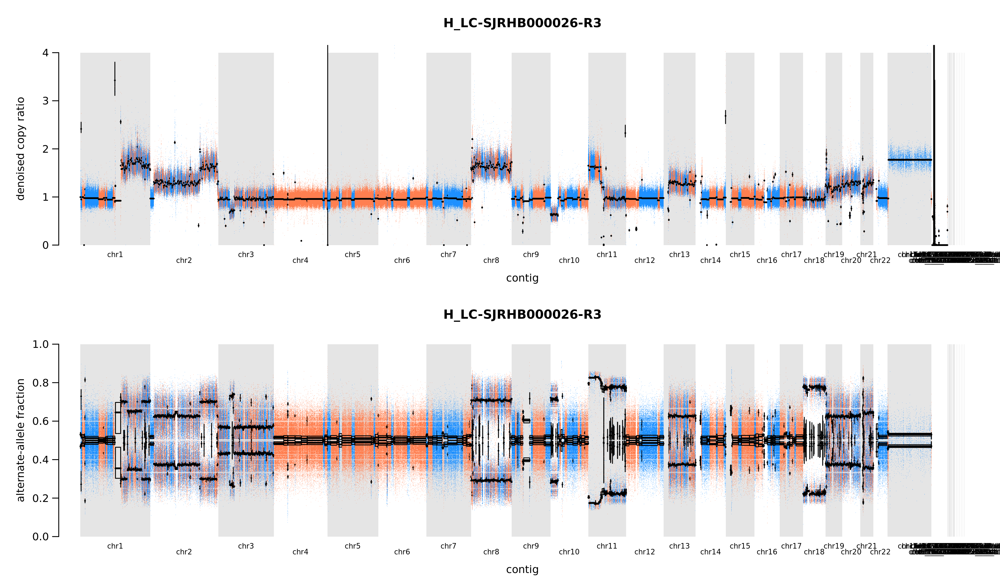

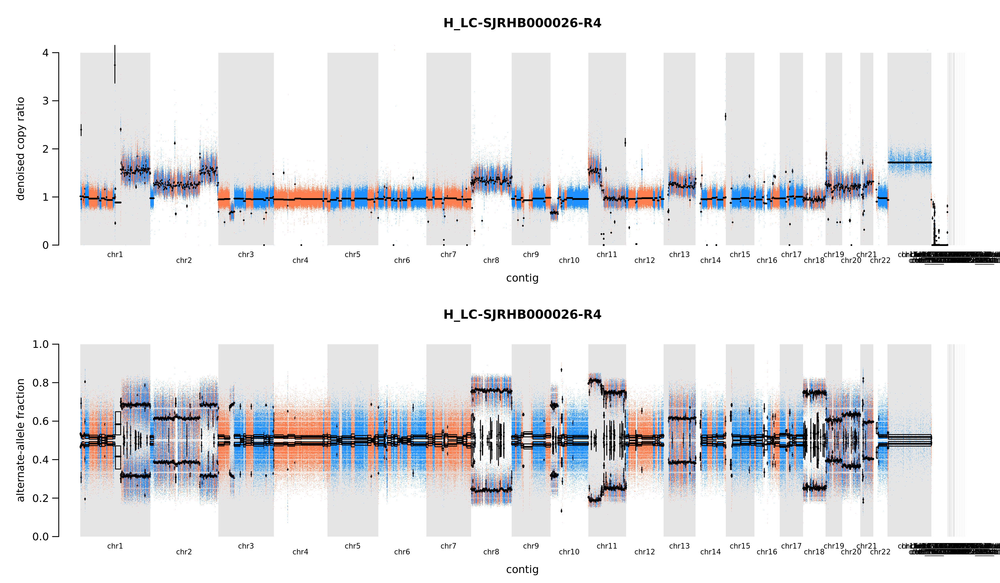

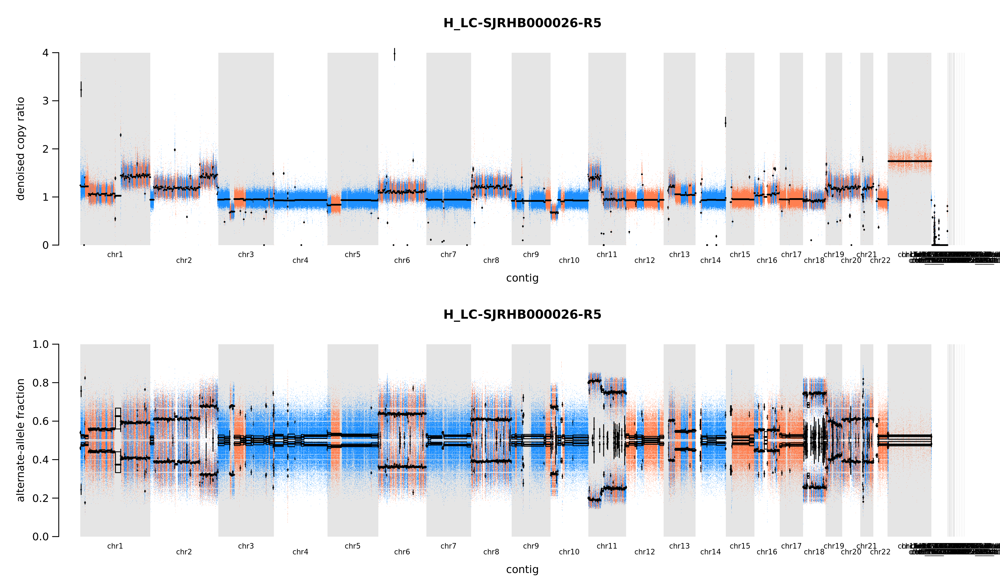

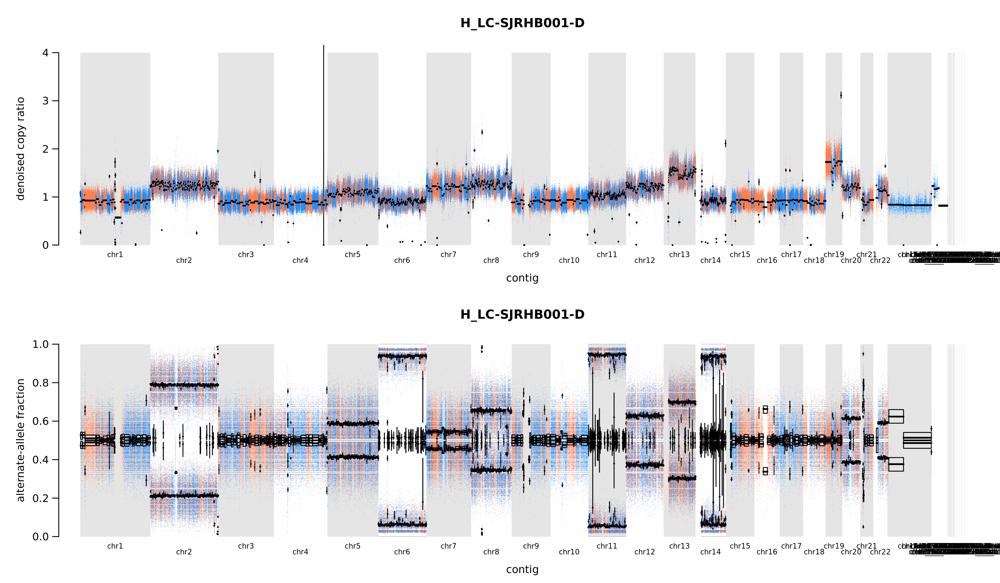

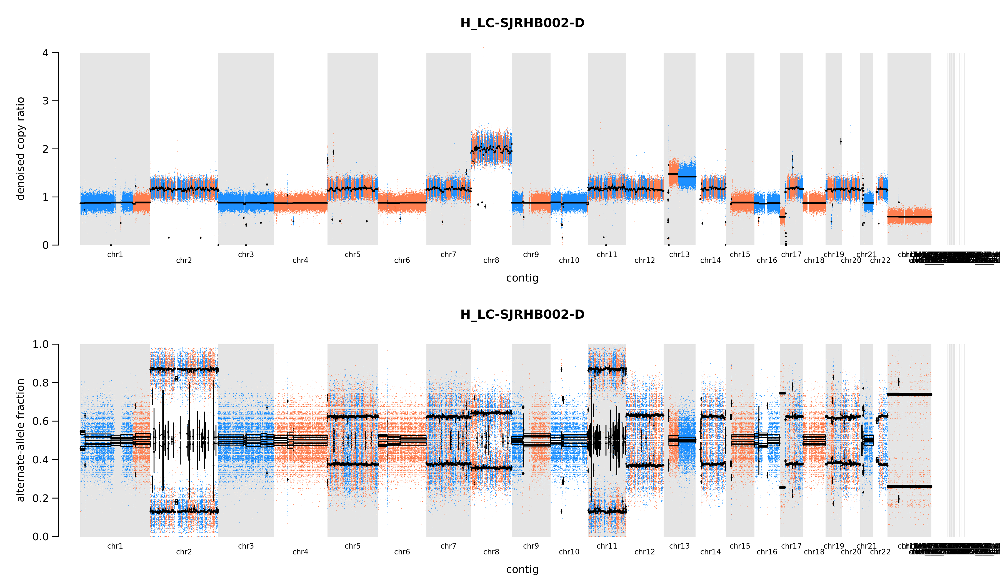

...

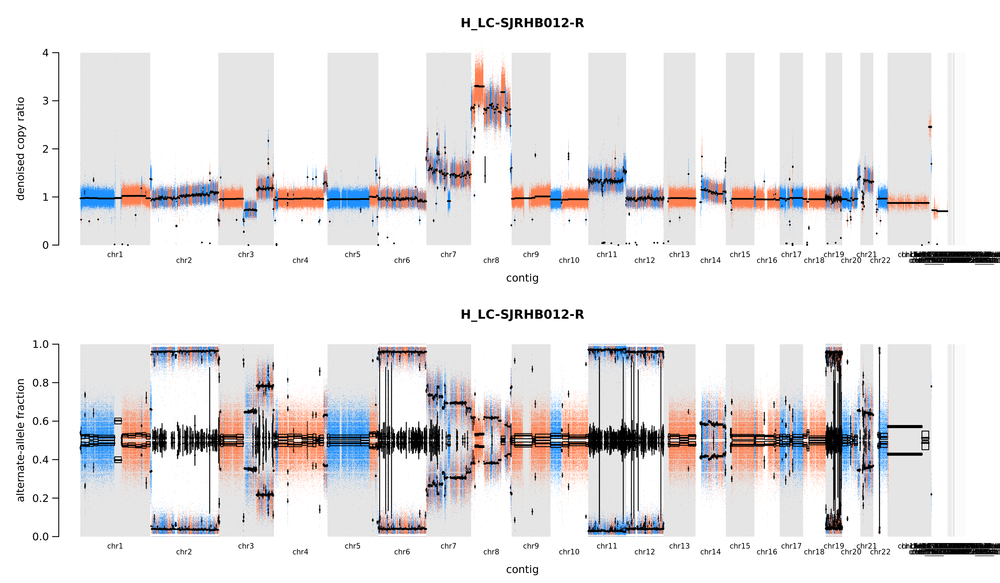

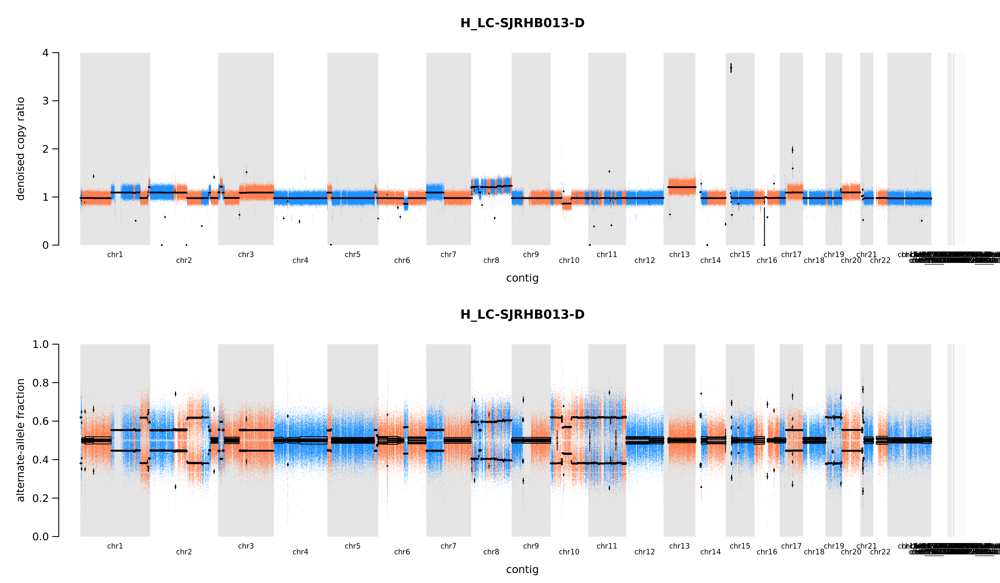

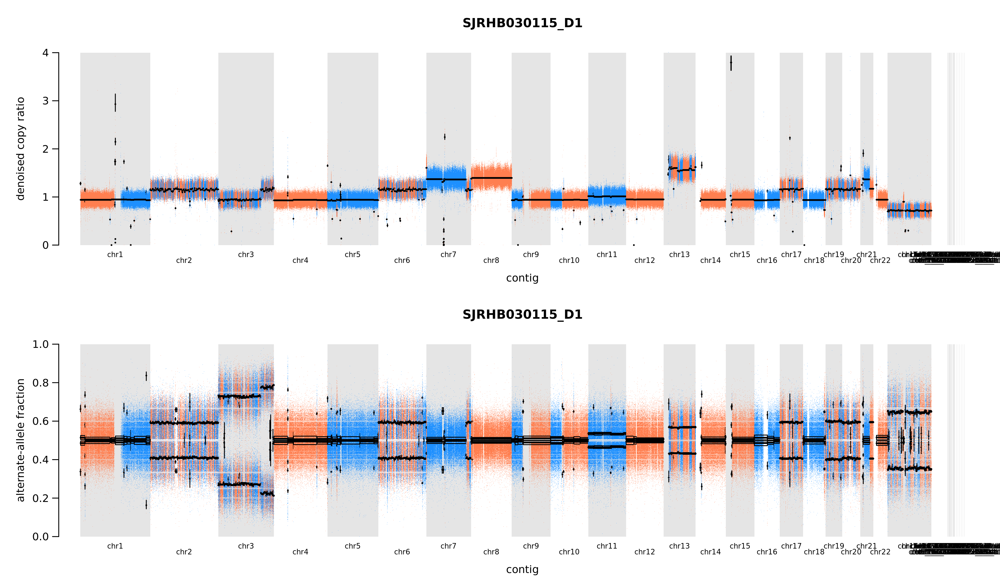

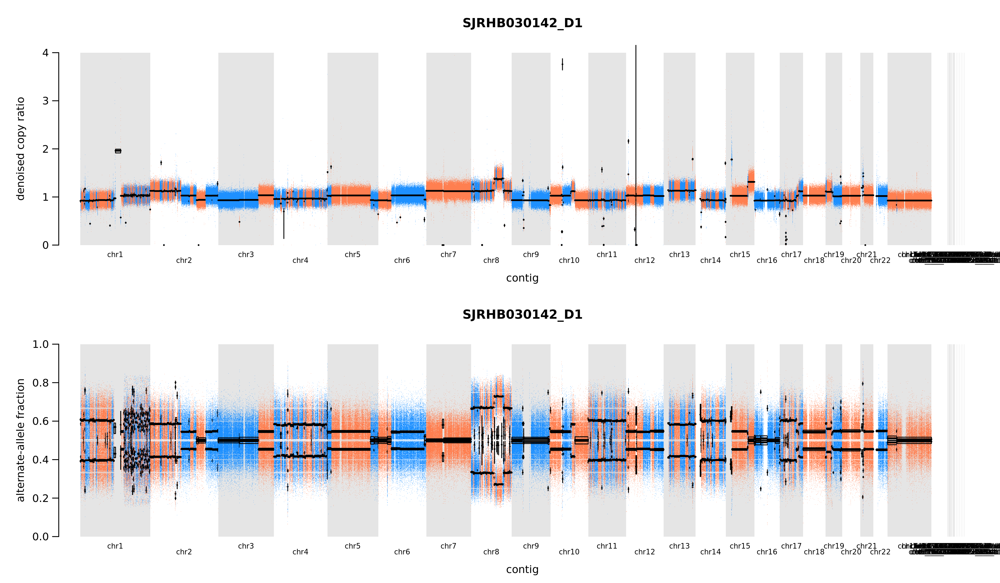

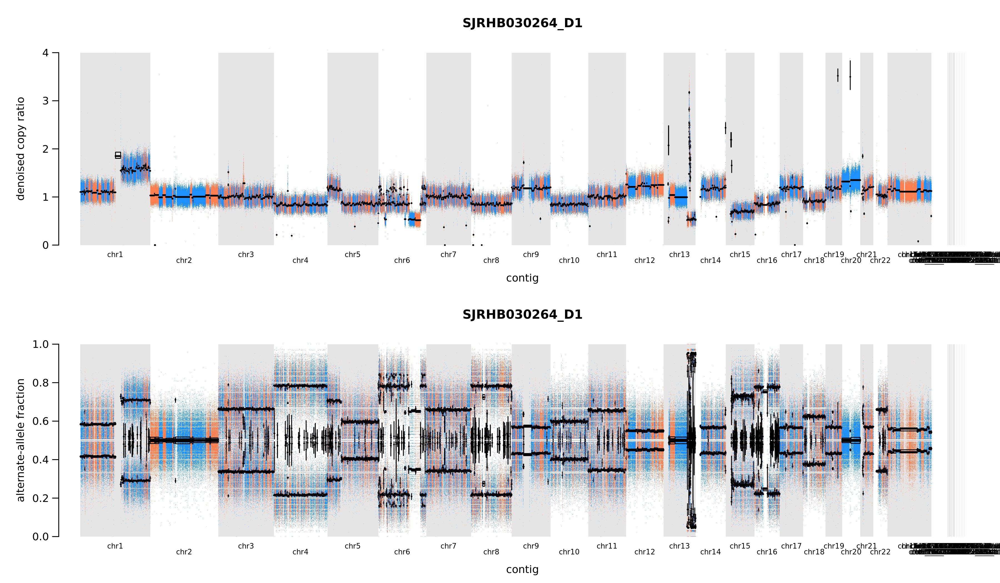

In [94]:
for plot in plots:
    display(Image('temp/'+plot.split('/')[-1]))

We are interested in seeing if there is 18q/VPS4B loss in RMS. We previously attempted to look at CN loss in an RMS dataset that used SOLID sequencing. However, our results were inconclusive due to problems with the quality of the data. We expected the data from St Jude's to be of much higher quality and that we should get a better sense of the CN profile of these tumors from this dataset.

### TODOS:

* Check the seg files in IGV look for hypo diploid samples with large gains/losses
* Before plotting - check on the sample metadata and remove some samples that are PDXs etc...
* Possibly run ABSOLUTE to get ploidy and whole genome doubling calls
* Summary figure of heatmap on 18q/SMAD4 sorted by deepest deletions

In [ ]:
%%R
st.jude.sample.info <- load.from.taiga(data.name='sample-annotations-7ca1', data.version=2, data.file='sample.info')

# Load the St Jude WES and WGS copy number data
st.jude.provided.bed.gene.cn <- load.from.taiga(data.name='copy-number-d4d9', data.version=6, data.file='st.jude.provided.bed.gene.cn')
st.jude.provided.bed.segmented.cn <- load.from.taiga(data.name='copy-number-d4d9', data.version=6, data.file='st.jude.provided.bed.segmented.cn')
wes.st.jude.gene.cn <- load.from.taiga(data.name='copy-number-d4d9', data.version=6, data.file='wes.st.jude.gene.cn')
wes.st.jude.segmented.cn <- load.from.taiga(data.name='copy-number-d4d9', data.version=6, data.file='wes.st.jude.segmented.cn')
wgs.st.jude.gene <- load.from.taiga(data.name='copy-number-d4d9', data.version=6, data.file='wgs.st.jude.gene')
wgs.st.jude.segmented <- load.from.taiga(data.name='copy-number-d4d9', data.version=6, data.file='wgs.st.jude.segmented')

cyto_band_file <- '~/Documents/Analysis/RScripts/Common_annotations/hg38_cytoband.gz'

In [ ]:
%%R 
total_segments_per_sample <- rbind(
  wgs.st.jude.segmented %>%
    dplyr::rename(Sample=DepMap_ID) %>%
    group_by(Sample) %>%
    dplyr::summarise(count=n()) %>%
    mutate(Source='WGS'),
  wes.st.jude.segmented.cn %>%
    group_by(Sample) %>%
    dplyr::summarise(count=n()) %>%
    mutate(Source='WES'),
  st.jude.provided.bed.segmented.cn %>%
    group_by(Sample) %>%
    dplyr::summarise(count=n()) %>%
    mutate(Source='BED')
)

In [ ]:
%%R
chr_cutoffs <- generate_chromosome_cutoffs_list(cyto_band_file = cyto_band_file)
columns_for_segment_plotting <- c('Sample', 'Chromosome', 'Start', 'End', 'Segment_Mean', 'Source')

In [ ]:
%%R
# The plots below give us a sense of the copy number profile of the samples 
continuous.wes.st.jude.segmented.cn <- wes.st.jude.segmented.cn %>%
  mutate(Start=Start+chr_cutoffs[paste0('chr', gsub('^chr', '', Chromosome))], End=End+chr_cutoffs[paste0('chr', gsub('^chr', '', Chromosome))]) %>%
  mutate(Source='WES') %>%
  dplyr::select(columns_for_segment_plotting)
continuous.wgs.st.jude.segmented.cn <- wgs.st.jude.segmented %>%
  mutate(Start=start+chr_cutoffs[paste0('chr', gsub('^chr', '', seqnames))], End=end+chr_cutoffs[paste0('chr', gsub('^chr', '', seqnames))]) %>%
  mutate(Source='WGS') %>%
  dplyr::rename(Sample=DepMap_ID, Chromosome=seqnames) %>%
  dplyr::select(columns_for_segment_plotting)
continuous.provided.bed.st.jude.segmented.cn <- st.jude.provided.bed.segmented.cn %>%
  mutate(Start=Start+chr_cutoffs[paste0('chr', gsub('^chr', '', Chromosome))], End=End+chr_cutoffs[paste0('chr', gsub('^chr', '', Chromosome))]) %>%
  dplyr::select(columns_for_segment_plotting)

combined_segments_all_sources <- rbind(continuous.wes.st.jude.segmented.cn, continuous.wgs.st.jude.segmented.cn, continuous.provided.bed.st.jude.segmented.cn)

# Plot the data
# (1) Filter out all the germline samples
tumor_samples_only <- st.jude.sample.info %>% filter(sample_type != 'Germline') %$% sample_name
tumor_segments_only <- combined_segments_all_sources %>% filter(Sample %in% tumor_samples_only)

sample_order_for_plot <- unique(tumor_segments_only$Sample)

# Plot
tumor_segments_only %<>% mutate(CN_capped=ifelse(log2(Segment_Mean) > 1, 1, ifelse(log2(Segment_Mean) < -1, -1, log2(Segment_Mean))))
tumor_segments_only %<>% mutate(Sample=factor(Sample, levels=sample_order_for_plot))
sample_labels <- setNames(seq(1, length(sample_order_for_plot)), sample_order_for_plot)

continuous_chromosome_plots_all <- ggplot(tumor_segments_only) +
  geom_rect(aes(xmin=Start, xmax=End, ymin=as.integer(Sample)-0.5, ymax=as.integer(Sample)+0.5, fill=CN_capped)) +
  scale_fill_gradient2(low='blue', high='red', mid='white', midpoint=0) +
  scale_x_continuous(breaks=chr_cutoffs, labels=names(chr_cutoffs)) +
  scale_y_continuous(breaks=sample_labels, labels=names(sample_labels)) +
  facet_wrap(~Source, ncol = 1) +
  theme(
    axis.text.x = element_text(angle=90, hjust=1, vjust=0.5, size=10),
    axis.text.y = element_text(size=10)
  )
ggsave(continuous_chromosome_plots_all, filename = file.path(plot_saving_directory, 'temp/continuous_segments_complete_all_source.pdf'), width=10, height = 30)

# Upload the validated results

In [44]:

tc = TaigaClient()
tc.update_dataset(dataset_permaname="copy-number-d4d9", 
                  upload_file_path_dict={'temp/wgs.st.jude.gene.cn': 'NumericMatrixCSV',
                                        'temp/wgs.st.jude.segmented.cn': 'TableCSV'},
                 dataset_description="updating to")

Now choosing the datasets you would want to keep or remove:
	Keep st.jude.provided.bed.segmented.cn ? (y/n) y
	Keep wgs.st.jude.gene ? (y/n) n
	Not keeping wgs.st.jude.gene
	Keep wes.st.jude.gene.cn ? (y/n) y
	Keep wgs.st.jude.segmented ? (y/n) n
	Not keeping wgs.st.jude.segmented
	Keep wes.st.jude.segmented.cn ? (y/n) y
	Keep st.jude.provided.bed.gene.cn ? (y/n) y
Uploading wgs.st.jude.gene...
hitting https://cds.team/taiga/api/datafile/87be153973e641f6ae69925887d28aa9
Conversion and upload...:

	 Done: wgs.st.jude.gene properly converted and uploaded
Uploading wgs.st.jude.segmented...
hitting https://cds.team/taiga/api/datafile/87be153973e641f6ae69925887d28aa9
Conversion and upload...:

	 Done: wgs.st.jude.segmented properly converted and uploaded
Creating the new version with these files:
	NEW: wgs.st.jude.gene - NumericMatrixCSV
	NEW: wgs.st.jude.segmented - TableCSV
	KEEP: st.jude.provided.bed.segmented.cn - Columnar
	KEEP: wes.st.jude.gene.cn - HDF5
	KEEP: wes.st.jude.segmented.c

'fb942dbaca464da79f344c020991914a'